In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.dates as md
import statsmodels.api as sm
from sklearn.model_selection import train_test_split
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import accuracy_score, precision_score, recall_score
import seaborn as sb
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import cross_val_score
from sklearn.datasets import make_classification
from sklearn.model_selection import cross_val_score
from xgboost import XGBClassifier
import time
import libpysal as ps
import geopandas as gpd
import folium
import mapclassify
from scipy.signal import find_peaks

In [2]:
crime = pd.read_csv("Crimes_-_2023.csv")
pd.set_option('display.max_columns', None)
crime

,ID,Case Number,Date,Block,IUCR,Primary Type,Description,Location Description,Arrest,Domestic,Beat,District,Ward,Community Area,FBI Code,X Coordinate,Y Coordinate,Year,Updated On,Latitude,Longitude,Location
0,13204489,JG416325,09/06/2023 11:00:00 AM,0000X E 8TH ST,0810,THEFT,OVER $500,PARKING LOT / GARAGE (NON RESIDENTIAL),False,False,123,1,4.0,32,06,1176857.0,1896680.0,2023,11/04/2023 03:40:18 PM,41.871835,-87.626151,"(41.871834768, -87.62615082)"
1,13045102,JG226663,03/30/2023 09:16:00 AM,080XX S DREXEL AVE,1544,SEX OFFENSE,SEXUAL EXPLOITATION OF A CHILD,APARTMENT,False,True,631,6,8.0,44,17,1183631.0,1851847.0,2023,09/14/2023 03:41:59 PM,41.748654,-87.602680,"(41.748653803, -87.602680492)"
2,13074891,JG262771,05/10/2023 12:43:00 PM,028XX N MANGO AVE,1754,OFFENSE INVOLVING CHILDREN,AGGRAVATED SEXUAL ASSAULT OF CHILD BY FAMILY M...,RESIDENCE,False,True,2514,25,30.0,19,02,1137557.0,1918320.0,2023,09/14/2023 03:41:59 PM,41.932015,-87.769917,"(41.932015426, -87.769916668)"
3,13099339,JG291745,04/01/2023 11:13:00 AM,020XX N LAPORTE AVE,1751,OFFENSE INVOLVING CHILDREN,CRIMINAL SEXUAL ABUSE BY FAMILY MEMBER,RESIDENCE,False,True,2522,25,26.0,19,17,1143059.0,1913090.0,2023,09/14/2023 03:41:59 PM,41.917563,-87.749828,"(41.917562778, -87.749828117)"
4,13121127,JG313964,06/22/2023 06:52:00 PM,015XX W NORTH AVE,1153,DECEPTIVE PRACTICE,FINANCIAL IDENTITY THEFT OVER $ 300,AUTO / BOAT / RV DEALERSHIP,True,False,1433,14,1.0,24,11,1165854.0,1910738.0,2023,09/14/2023 03:41:59 PM,41.910653,-87.666146,"(41.91065261, -87.66614577)"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
242729,27322,JG131679,01/27/2023 02:06:00 PM,095XX S BENNETT AVE,0110,HOMICIDE,FIRST DEGREE MURDER,HOUSE,True,True,431,4,7.0,51,01A,1190517.0,1842023.0,2023,02/08/2023 03:40:16 PM,41.721533,-87.577764,"(41.721532572, -87.577764122)"
242730,27334,JG145885,02/08/2023 11:24:00 PM,025XX S WABASH AVE,0110,HOMICIDE,FIRST DEGREE MURDER,STREET,False,False,133,1,3.0,33,01A,1177151.0,1887463.0,2023,02/15/2023 03:41:05 PM,41.846536,-87.625350,"(41.846536062, -87.625350476)"
242731,27435,JG224023,04/15/2023 07:35:00 AM,005XX N LAMON AVE,0110,HOMICIDE,FIRST DEGREE MURDER,STREET,False,False,1532,15,37.0,25,01A,1143593.0,1903311.0,2023,04/22/2023 03:41:17 PM,41.890718,-87.748111,"(41.890718131, -87.74811127)"
242732,27289,JG107068,01/06/2023 09:25:00 PM,056XX S THROOP ST,0110,HOMICIDE,FIRST DEGREE MURDER,HOUSE,True,False,713,7,16.0,67,01A,1168619.0,1867434.0,2023,04/13/2023 03:40:28 PM,41.791763,-87.657241,"(41.791763159, -87.657240734)"


In [3]:
crime.dtypes

ID                        int64
Case Number              object
Date                     object
Block                    object
IUCR                     object
Primary Type             object
Description              object
Location Description     object
Arrest                     bool
Domestic                   bool
Beat                      int64
District                  int64
Ward                    float64
Community Area            int64
FBI Code                 object
X Coordinate            float64
Y Coordinate            float64
Year                      int64
Updated On               object
Latitude                float64
Longitude               float64
Location                 object
dtype: object

In [4]:
crime[crime[["Date"]].isna().any(axis=1)]

,ID,Case Number,Date,Block,IUCR,Primary Type,Description,Location Description,Arrest,Domestic,Beat,District,Ward,Community Area,FBI Code,X Coordinate,Y Coordinate,Year,Updated On,Latitude,Longitude,Location


In [5]:
#create timestamp objects
crime.Date = pd.to_datetime(crime.Date, format='%m/%d/%Y %I:%M:%S %p')
crime.Date

0        2023-09-06 11:00:00
1        2023-03-30 09:16:00
2        2023-05-10 12:43:00
3        2023-04-01 11:13:00
4        2023-06-22 18:52:00
                 ...        
242729   2023-01-27 14:06:00
242730   2023-02-08 23:24:00
242731   2023-04-15 07:35:00
242732   2023-01-06 21:25:00
242733   2023-06-20 12:42:00
Name: Date, Length: 242734, dtype: datetime64[ns]

In [6]:
crime.head()

,ID,Case Number,Date,Block,IUCR,Primary Type,Description,Location Description,Arrest,Domestic,Beat,District,Ward,Community Area,FBI Code,X Coordinate,Y Coordinate,Year,Updated On,Latitude,Longitude,Location
0,13204489,JG416325,2023-09-06 11:00:00,0000X E 8TH ST,0810,THEFT,OVER $500,PARKING LOT / GARAGE (NON RESIDENTIAL),False,False,123,1,4.0,32,06,1176857.0,1896680.0,2023,11/04/2023 03:40:18 PM,41.871835,-87.626151,"(41.871834768, -87.62615082)"
1,13045102,JG226663,2023-03-30 09:16:00,080XX S DREXEL AVE,1544,SEX OFFENSE,SEXUAL EXPLOITATION OF A CHILD,APARTMENT,False,True,631,6,8.0,44,17,1183631.0,1851847.0,2023,09/14/2023 03:41:59 PM,41.748654,-87.602680,"(41.748653803, -87.602680492)"
2,13074891,JG262771,2023-05-10 12:43:00,028XX N MANGO AVE,1754,OFFENSE INVOLVING CHILDREN,AGGRAVATED SEXUAL ASSAULT OF CHILD BY FAMILY M...,RESIDENCE,False,True,2514,25,30.0,19,02,1137557.0,1918320.0,2023,09/14/2023 03:41:59 PM,41.932015,-87.769917,"(41.932015426, -87.769916668)"
3,13099339,JG291745,2023-04-01 11:13:00,020XX N LAPORTE AVE,1751,OFFENSE INVOLVING CHILDREN,CRIMINAL SEXUAL ABUSE BY FAMILY MEMBER,RESIDENCE,False,True,2522,25,26.0,19,17,1143059.0,1913090.0,2023,09/14/2023 03:41:59 PM,41.917563,-87.749828,"(41.917562778, -87.749828117)"
4,13121127,JG313964,2023-06-22 18:52:00,015XX W NORTH AVE,1153,DECEPTIVE PRACTICE,FINANCIAL IDENTITY THEFT OVER $ 300,AUTO / BOAT / RV DEALERSHIP,True,False,1433,14,1.0,24,11,1165854.0,1910738.0,2023,09/14/2023 03:41:59 PM,41.910653,-87.666146,"(41.91065261, -87.66614577)"


In [7]:
print(crime['Primary Type'].unique())
print(len(crime['Primary Type'].unique()))
class_sizes = crime.groupby('Primary Type').size()
print(class_sizes)
print(class_sizes[class_sizes > len(crime)*0.001])
len(class_sizes[class_sizes > len(crime)*0.001])

['THEFT' 'SEX OFFENSE' 'OFFENSE INVOLVING CHILDREN' 'DECEPTIVE PRACTICE'
 'STALKING' 'MOTOR VEHICLE THEFT' 'CRIMINAL DAMAGE' 'CRIMINAL TRESPASS'
 'BATTERY' 'OTHER OFFENSE' 'ASSAULT' 'PROSTITUTION' 'BURGLARY' 'NARCOTICS'
 'ROBBERY' 'KIDNAPPING' 'ARSON' 'CONCEALED CARRY LICENSE VIOLATION'
 'WEAPONS VIOLATION' 'CRIMINAL SEXUAL ASSAULT'
 'INTERFERENCE WITH PUBLIC OFFICER' 'PUBLIC PEACE VIOLATION' 'HOMICIDE'
 'LIQUOR LAW VIOLATION' 'INTIMIDATION' 'GAMBLING' 'OBSCENITY'
 'HUMAN TRAFFICKING' 'NON-CRIMINAL' 'PUBLIC INDECENCY'
 'OTHER NARCOTIC VIOLATION']
31
Primary Type
ARSON                                  467
ASSAULT                              21083
BATTERY                              41250
BURGLARY                              6920
CONCEALED CARRY LICENSE VIOLATION      189
CRIMINAL DAMAGE                      28025
CRIMINAL SEXUAL ASSAULT               1481
CRIMINAL TRESPASS                     4389
DECEPTIVE PRACTICE                   14940
GAMBLING                                14
H

20

In [8]:
crime["Class"] = 0

crime.loc[(crime['Primary Type'] == 'OTHER OFFENSE') | (crime['Primary Type'] == 'LIQUOR LAW VIOLATION') | (crime['Primary Type'] == 'OBSCENITY') | (crime['Primary Type'] == 'GAMBLING')| (crime['Primary Type'] == 'PUBLIC INDECENCY') | (crime['Primary Type'] == 'PUBLIC PEACE VIOLATION') | (crime['Primary Type'] == 'OTHER NARCOTIC VIOLATION'), 'Class'] = 1
crime.loc[(crime['Primary Type'] == 'CONCEALED CARRY LICENSE VIOLATION') | (crime['Primary Type'] == 'PROSTITUTION') | (crime['Primary Type'] == 'INTERFERENCE WITH PUBLIC OFFICER') | (crime['Primary Type'] == 'WEAPONS VIOLATION') | (crime['Primary Type'] == 'NARCOTICS'), 'Class'] = 2
crime.loc[(crime['Primary Type'] == 'CRIMINAL DAMAGE') | (crime['Primary Type'] == 'THEFT') | (crime['Primary Type'] == 'DECEPTIVE PRACTICE') | (crime['Primary Type'] == 'BURGLARY') | (crime['Primary Type'] == 'INTIMIDATION') | (crime['Primary Type'] == 'STALKING') | (crime['Primary Type'] == 'CRIMINAL TRESPASS'), 'Class'] = 3
crime.loc[(crime['Primary Type'] == 'ARSON') | (crime['Primary Type'] == 'ROBBERY') | (crime['Primary Type'] == 'MOTOR VEHICLE THEFT') | (crime['Primary Type'] == 'ASSAULT') | (crime['Primary Type'] == 'KIDNAPPING'), 'Class'] = 4
crime.loc[(crime['Primary Type'] == 'CRIMINAL SEXUAL ASSAULT') | (crime['Primary Type'] == 'BATTERY') | (crime['Primary Type'] == 'SEX OFFENSE'), 'Class'] = 5
crime.loc[(crime['Primary Type'] == 'OFFENSE INVOLVING CHILDREN') | (crime['Primary Type'] == 'HUMAN TRAFFICKING') | (crime['Primary Type'] == 'HOMICIDE'), 'Class'] = 6
crime.head(10)

,ID,Case Number,Date,Block,IUCR,Primary Type,Description,Location Description,Arrest,Domestic,Beat,District,Ward,Community Area,FBI Code,X Coordinate,Y Coordinate,Year,Updated On,Latitude,Longitude,Location,Class
0,13204489,JG416325,2023-09-06 11:00:00,0000X E 8TH ST,0810,THEFT,OVER $500,PARKING LOT / GARAGE (NON RESIDENTIAL),False,False,123,1,4.0,32,06,1176857.0,1896680.0,2023,11/04/2023 03:40:18 PM,41.871835,-87.626151,"(41.871834768, -87.62615082)",3
1,13045102,JG226663,2023-03-30 09:16:00,080XX S DREXEL AVE,1544,SEX OFFENSE,SEXUAL EXPLOITATION OF A CHILD,APARTMENT,False,True,631,6,8.0,44,17,1183631.0,1851847.0,2023,09/14/2023 03:41:59 PM,41.748654,-87.602680,"(41.748653803, -87.602680492)",5
2,13074891,JG262771,2023-05-10 12:43:00,028XX N MANGO AVE,1754,OFFENSE INVOLVING CHILDREN,AGGRAVATED SEXUAL ASSAULT OF CHILD BY FAMILY M...,RESIDENCE,False,True,2514,25,30.0,19,02,1137557.0,1918320.0,2023,09/14/2023 03:41:59 PM,41.932015,-87.769917,"(41.932015426, -87.769916668)",6
3,13099339,JG291745,2023-04-01 11:13:00,020XX N LAPORTE AVE,1751,OFFENSE INVOLVING CHILDREN,CRIMINAL SEXUAL ABUSE BY FAMILY MEMBER,RESIDENCE,False,True,2522,25,26.0,19,17,1143059.0,1913090.0,2023,09/14/2023 03:41:59 PM,41.917563,-87.749828,"(41.917562778, -87.749828117)",6
4,13121127,JG313964,2023-06-22 18:52:00,015XX W NORTH AVE,1153,DECEPTIVE PRACTICE,FINANCIAL IDENTITY THEFT OVER $ 300,AUTO / BOAT / RV DEALERSHIP,True,False,1433,14,1.0,24,11,1165854.0,1910738.0,2023,09/14/2023 03:41:59 PM,41.910653,-87.666146,"(41.91065261, -87.66614577)",3
5,13124701,JG321999,2023-06-30 04:00:00,007XX E 111TH ST,0583,STALKING,CYBERSTALKING,POLICE FACILITY / VEHICLE PARKING LOT,True,False,531,5,9.0,50,08A,1183356.0,1831503.0,2023,09/14/2023 03:41:59 PM,41.692834,-87.604319,"(41.692833841, -87.60431945)",3
6,13129199,JG327622,2023-07-04 17:30:00,047XX S CALUMET AVE,0910,MOTOR VEHICLE THEFT,AUTOMOBILE,STREET,True,False,224,2,3.0,38,07,1179230.0,1873766.0,2023,09/14/2023 03:41:59 PM,41.808903,-87.618139,"(41.80890316, -87.618139193)",4
7,13176001,JG382803,2023-02-01 14:00:00,058XX S MICHIGAN AVE,1562,SEX OFFENSE,AGGRAVATED CRIMINAL SEXUAL ABUSE,APARTMENT,True,True,232,2,20.0,40,17,1178158.0,1866236.0,2023,09/14/2023 03:41:59 PM,41.788265,-87.622299,"(41.788264552, -87.62229949)",5
8,13179181,JG386523,2023-08-17 15:15:00,020XX N MILWAUKEE AVE,0860,THEFT,RETAIL THEFT,DEPARTMENT STORE,True,False,1431,14,1.0,22,06,1159682.0,1913243.0,2023,09/14/2023 03:41:59 PM,41.917656,-87.688750,"(41.917656022, -87.688750258)",3
9,13179344,JG386917,2023-08-17 19:25:00,030XX N ELBRIDGE AVE,0860,THEFT,RETAIL THEFT,STREET,True,False,1412,14,35.0,21,06,1152158.0,1919830.0,2023,09/14/2023 03:41:59 PM,41.935883,-87.716220,"(41.935883156, -87.716219645)",3


<Axes: xlabel='Class'>

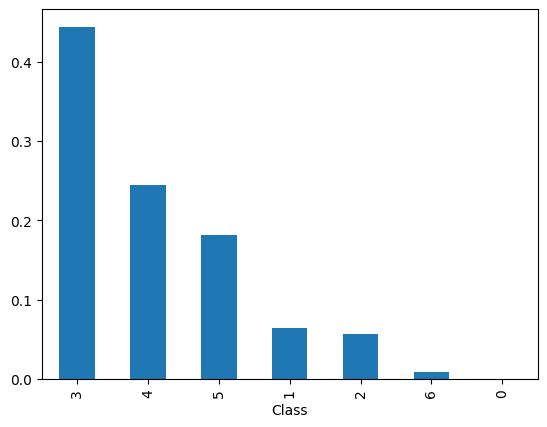

In [9]:
crime["Class"].value_counts(normalize=True).plot(kind='bar') 

In [10]:
#round dates to the nearest half hour
crime['Date'] = crime['Date'].dt.round('30min')  
crime

,ID,Case Number,Date,Block,IUCR,Primary Type,Description,Location Description,Arrest,Domestic,Beat,District,Ward,Community Area,FBI Code,X Coordinate,Y Coordinate,Year,Updated On,Latitude,Longitude,Location,Class
0,13204489,JG416325,2023-09-06 11:00:00,0000X E 8TH ST,0810,THEFT,OVER $500,PARKING LOT / GARAGE (NON RESIDENTIAL),False,False,123,1,4.0,32,06,1176857.0,1896680.0,2023,11/04/2023 03:40:18 PM,41.871835,-87.626151,"(41.871834768, -87.62615082)",3
1,13045102,JG226663,2023-03-30 09:30:00,080XX S DREXEL AVE,1544,SEX OFFENSE,SEXUAL EXPLOITATION OF A CHILD,APARTMENT,False,True,631,6,8.0,44,17,1183631.0,1851847.0,2023,09/14/2023 03:41:59 PM,41.748654,-87.602680,"(41.748653803, -87.602680492)",5
2,13074891,JG262771,2023-05-10 12:30:00,028XX N MANGO AVE,1754,OFFENSE INVOLVING CHILDREN,AGGRAVATED SEXUAL ASSAULT OF CHILD BY FAMILY M...,RESIDENCE,False,True,2514,25,30.0,19,02,1137557.0,1918320.0,2023,09/14/2023 03:41:59 PM,41.932015,-87.769917,"(41.932015426, -87.769916668)",6
3,13099339,JG291745,2023-04-01 11:00:00,020XX N LAPORTE AVE,1751,OFFENSE INVOLVING CHILDREN,CRIMINAL SEXUAL ABUSE BY FAMILY MEMBER,RESIDENCE,False,True,2522,25,26.0,19,17,1143059.0,1913090.0,2023,09/14/2023 03:41:59 PM,41.917563,-87.749828,"(41.917562778, -87.749828117)",6
4,13121127,JG313964,2023-06-22 19:00:00,015XX W NORTH AVE,1153,DECEPTIVE PRACTICE,FINANCIAL IDENTITY THEFT OVER $ 300,AUTO / BOAT / RV DEALERSHIP,True,False,1433,14,1.0,24,11,1165854.0,1910738.0,2023,09/14/2023 03:41:59 PM,41.910653,-87.666146,"(41.91065261, -87.66614577)",3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
242729,27322,JG131679,2023-01-27 14:00:00,095XX S BENNETT AVE,0110,HOMICIDE,FIRST DEGREE MURDER,HOUSE,True,True,431,4,7.0,51,01A,1190517.0,1842023.0,2023,02/08/2023 03:40:16 PM,41.721533,-87.577764,"(41.721532572, -87.577764122)",6
242730,27334,JG145885,2023-02-08 23:30:00,025XX S WABASH AVE,0110,HOMICIDE,FIRST DEGREE MURDER,STREET,False,False,133,1,3.0,33,01A,1177151.0,1887463.0,2023,02/15/2023 03:41:05 PM,41.846536,-87.625350,"(41.846536062, -87.625350476)",6
242731,27435,JG224023,2023-04-15 07:30:00,005XX N LAMON AVE,0110,HOMICIDE,FIRST DEGREE MURDER,STREET,False,False,1532,15,37.0,25,01A,1143593.0,1903311.0,2023,04/22/2023 03:41:17 PM,41.890718,-87.748111,"(41.890718131, -87.74811127)",6
242732,27289,JG107068,2023-01-06 21:30:00,056XX S THROOP ST,0110,HOMICIDE,FIRST DEGREE MURDER,HOUSE,True,False,713,7,16.0,67,01A,1168619.0,1867434.0,2023,04/13/2023 03:40:28 PM,41.791763,-87.657241,"(41.791763159, -87.657240734)",6


In [11]:
#create dataframes for a single day a single week and a single month
day = pd.date_range(start = "2023-01-07", end="2023-01-07 23:59:59", periods=24*60*60)
crime_day = crime[crime["Date"].isin(day)]

week= pd.date_range(start = "2023-01-08", end="2023-01-14 23:59:59", periods=7*24*60*60)
crime_week = crime[crime["Date"].isin(week)]

month = pd.date_range(start = "2023-01-08", end="2023-02-7 23:59:59", periods=31*24*60*60)
crime_month = crime[crime["Date"].isin(month)]
crime_month

,ID,Case Number,Date,Block,IUCR,Primary Type,Description,Location Description,Arrest,Domestic,Beat,District,Ward,Community Area,FBI Code,X Coordinate,Y Coordinate,Year,Updated On,Latitude,Longitude,Location,Class
7,13176001,JG382803,2023-02-01 14:00:00,058XX S MICHIGAN AVE,1562,SEX OFFENSE,AGGRAVATED CRIMINAL SEXUAL ABUSE,APARTMENT,True,True,232,2,20.0,40,17,1178158.0,1866236.0,2023,09/14/2023 03:41:59 PM,41.788265,-87.622299,"(41.788264552, -87.62229949)",5
951,13209667,JG422080,2023-01-12 08:30:00,013XX E 59TH ST,0810,THEFT,OVER $500,SCHOOL - PRIVATE GROUNDS,False,False,235,2,5.0,41,06,1186172.0,1866149.0,2023,09/15/2023 03:41:25 PM,41.787840,-87.592918,"(41.787840189, -87.592918325)",3
1416,13209657,JG422289,2023-02-02 08:00:00,018XX N HONORE ST,1153,DECEPTIVE PRACTICE,FINANCIAL IDENTITY THEFT OVER $ 300,NaN,False,False,1434,14,32.0,22,11,1163731.0,1912220.0,2023,09/15/2023 03:41:25 PM,41.914764,-87.673903,"(41.914764369, -87.673903013)",3
1527,13208805,JG421503,2023-02-03 10:00:00,047XX S PRAIRIE AVE,0820,THEFT,$500 AND UNDER,STREET,False,False,224,2,3.0,38,06,1178840.0,1873667.0,2023,09/15/2023 03:41:25 PM,41.808640,-87.619573,"(41.808640392, -87.619572637)",3
3104,12971916,JG135076,2023-01-27 15:00:00,015XX W FILLMORE ST,1563,SEX OFFENSE,CRIMINAL SEXUAL ABUSE,SCHOOL - PUBLIC BUILDING,True,False,1231,12,28.0,28,17,1166394.0,1895381.0,2023,09/18/2023 03:41:36 PM,41.868500,-87.664602,"(41.868500324, -87.664601688)",5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
242693,27316,JG126633,2023-01-23 15:30:00,029XX E 78TH ST,0110,HOMICIDE,FIRST DEGREE MURDER,APARTMENT,False,False,421,4,7.0,43,01A,1196973.0,1853908.0,2023,01/30/2023 03:41:58 PM,41.753988,-87.553723,"(41.753988038, -87.55372311)",6
242698,27326,JG137081,2023-02-01 14:30:00,019XX W GARFIELD BLVD,0110,HOMICIDE,FIRST DEGREE MURDER,STREET,True,False,715,7,16.0,67,01A,1164182.0,1868054.0,2023,05/18/2023 03:40:24 PM,41.793559,-87.673493,"(41.793559117, -87.673492986)",6
242704,27309,JG124468,2023-01-21 16:30:00,111XX S VERNON AVE,0110,HOMICIDE,FIRST DEGREE MURDER,APARTMENT,True,False,531,5,9.0,49,01A,1181220.0,1831281.0,2023,02/17/2023 03:40:22 PM,41.692274,-87.612146,"(41.692273984, -87.612146482)",6
242725,27305,JG122712,2023-01-20 06:30:00,073XX S WABASH AVE,0110,HOMICIDE,FIRST DEGREE MURDER,YARD,False,False,323,3,6.0,69,01A,1177994.0,1856294.0,2023,01/27/2023 03:42:40 PM,41.760986,-87.623202,"(41.760986379, -87.623201821)",6


In [12]:
#sum class and date
summed_values = crime_day.groupby(['Date', 'Class'])['Class'].count()
summed_values_unstacked = summed_values.unstack()
summed_values_unstacked = summed_values_unstacked.fillna(0)
summed_values_unstacked

summed_values_week = crime_week.groupby(['Date', 'Class'])['Class'].count()
summed_values_week_unstacked = summed_values_week.unstack()
summed_values_week_unstacked = summed_values_week_unstacked.fillna(0)
summed_values_week_unstacked

summed_values_month = crime_month.groupby(['Date', 'Class'])['Class'].count()
summed_values_month_unstacked = summed_values_month.unstack()
summed_values_month_unstacked = summed_values_month_unstacked.fillna(0)
summed_values_month_unstacked

Class,1,2,3,4,5,6
Date,,,,,,
2023-01-08 00:00:00,2.0,1.0,20.0,7.0,7.0,0.0
2023-01-08 00:30:00,0.0,2.0,3.0,5.0,4.0,0.0
2023-01-08 01:00:00,0.0,1.0,8.0,6.0,6.0,0.0
2023-01-08 01:30:00,3.0,2.0,4.0,3.0,0.0,0.0
2023-01-08 02:00:00,2.0,1.0,5.0,6.0,5.0,0.0
...,...,...,...,...,...,...
2023-02-07 21:30:00,1.0,1.0,1.0,7.0,2.0,0.0
2023-02-07 22:00:00,3.0,3.0,4.0,4.0,0.0,0.0
2023-02-07 22:30:00,0.0,1.0,2.0,2.0,1.0,0.0


<function matplotlib.pyplot.show(close=None, block=None)>

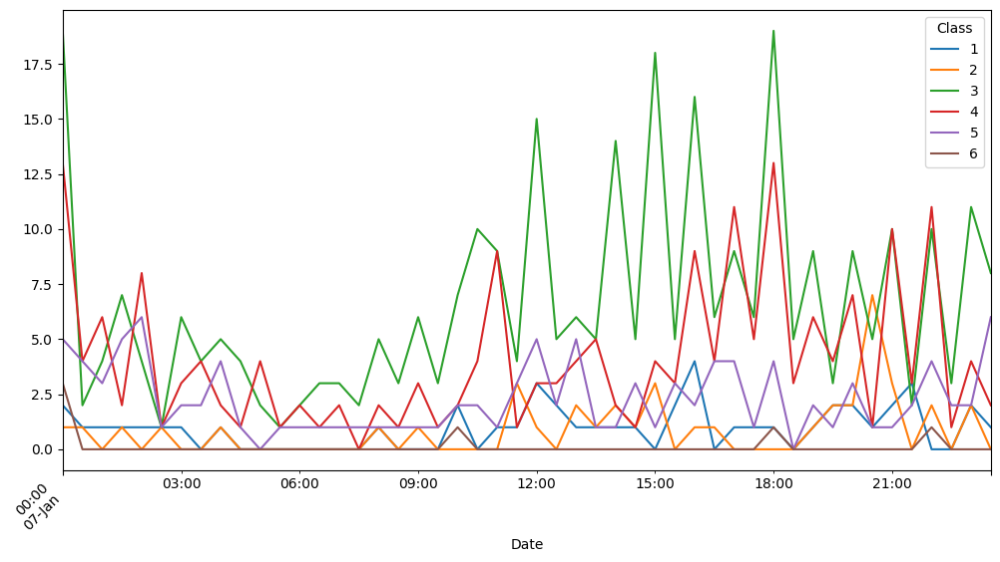

In [13]:
fig, ax = plt.subplots(figsize=(12, 6))
summed_values_unstacked.plot(ax=ax)
plt.xticks(rotation=45, ha='right')
plt.show

<function matplotlib.pyplot.show(close=None, block=None)>

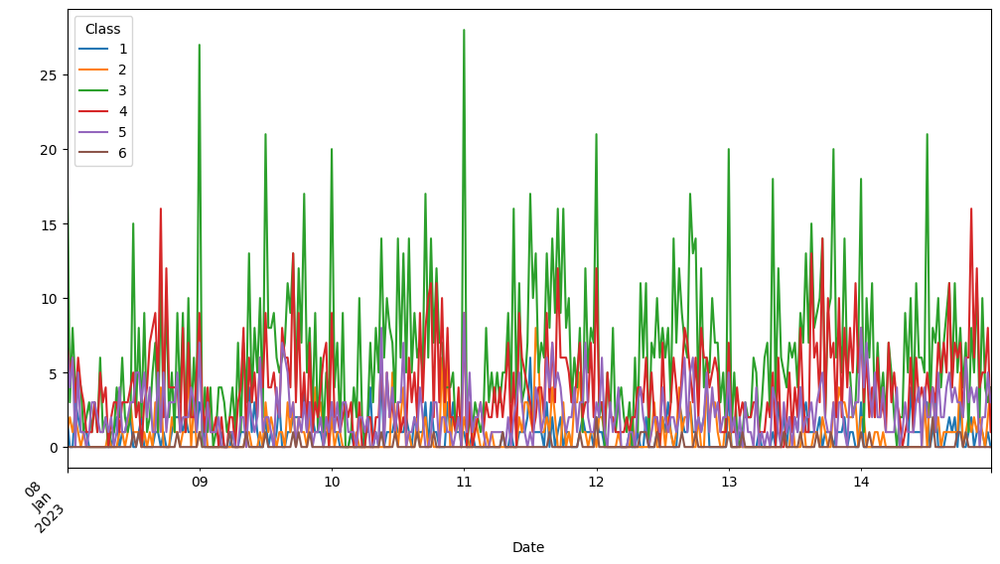

In [14]:
fig, ax = plt.subplots(figsize=(12, 6))
summed_values_week_unstacked.plot(ax=ax)
plt.xticks(rotation=45, ha='right')
plt.show

<function matplotlib.pyplot.show(close=None, block=None)>

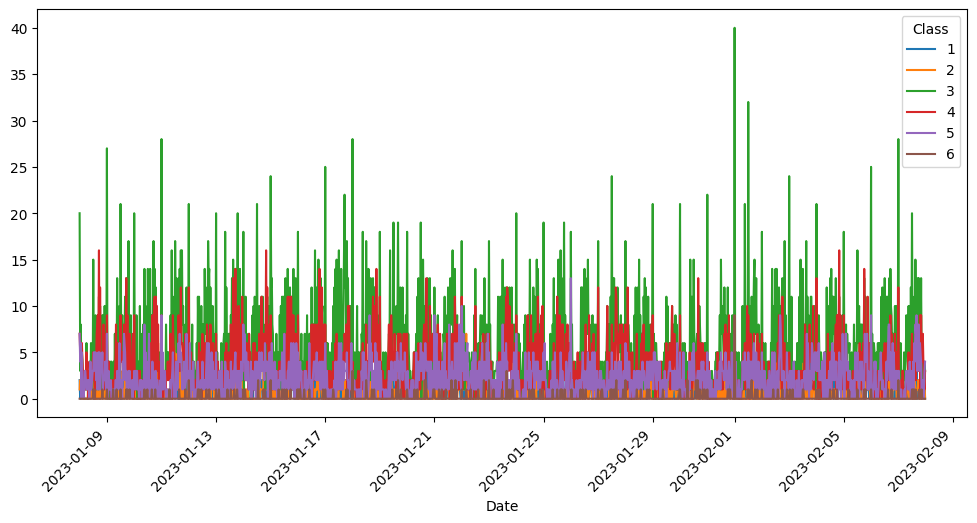

In [15]:
fig, ax = plt.subplots(figsize=(12, 6))
summed_values_month_unstacked.plot(ax=ax)
plt.xticks(rotation=45, ha='right')
plt.show

<function matplotlib.pyplot.show(close=None, block=None)>

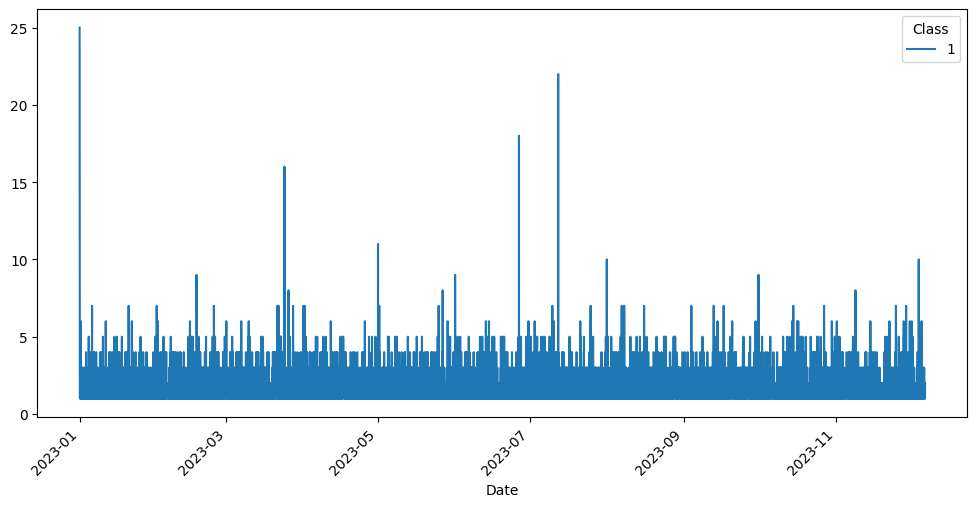

In [16]:
summed_values_year = crime[crime["Class"]==1].groupby(['Date', 'Class'])['Class'].count()
summed_values_year_unstacked = summed_values_year.unstack()
summed_values_year_unstacked = summed_values_year_unstacked.fillna(0)
summed_values_year_unstacked

fig, ax = plt.subplots(figsize=(12, 6))
summed_values_year_unstacked.plot(ax=ax)
plt.xticks(rotation=45, ha='right')
plt.show

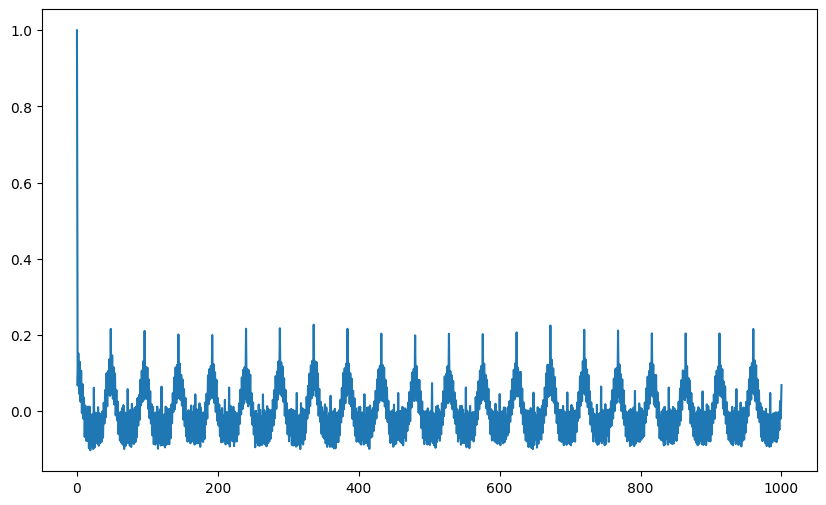

In [17]:
all_dates = pd.DataFrame({"Date" : pd.date_range(start=crime['Date'].min(), end=crime['Date'].max(), freq='30T')})
class1_full = all_dates.merge(crime[crime['Class'] == 1], on="Date", how = "left")
summed_values1 = class1_full.groupby('Date')['Class'].count()
summed_values1

acf_c1 = sm.tsa.stattools.acf(summed_values1, nlags = 1000)
fig, ax = plt.subplots(figsize=(10, 6))
plt.plot(acf_c1)


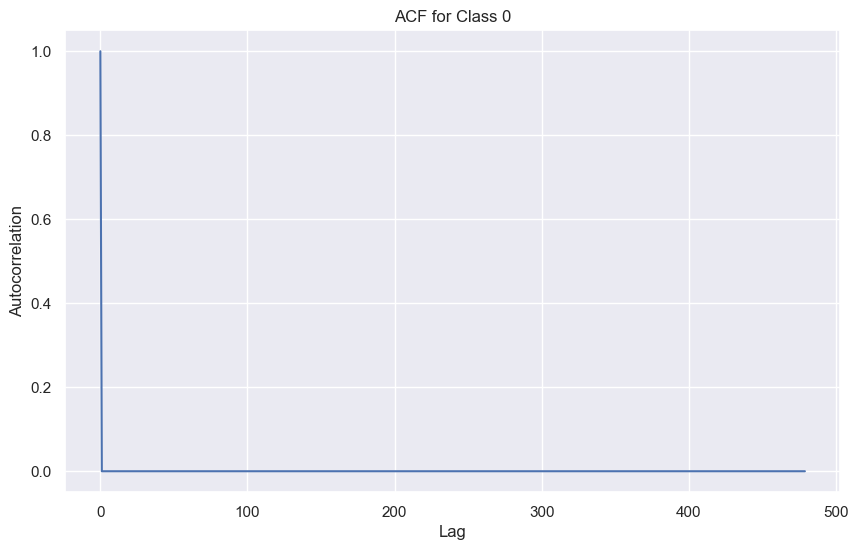

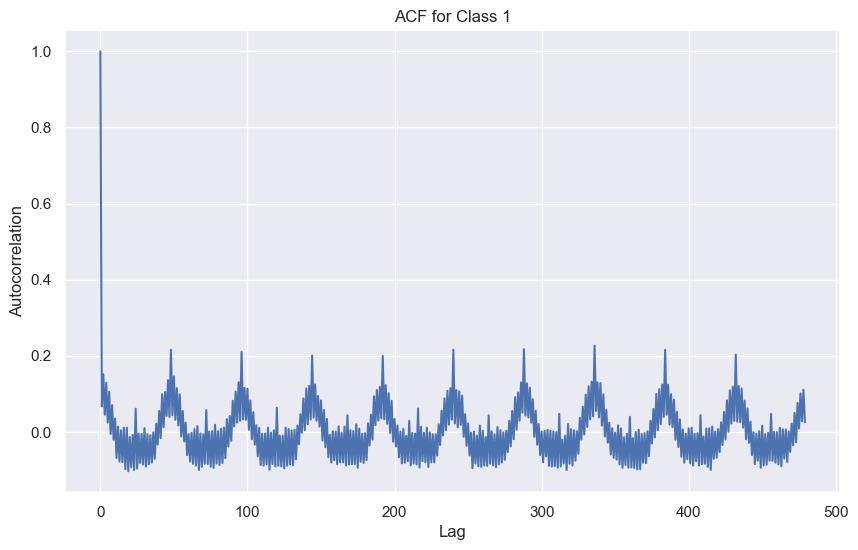

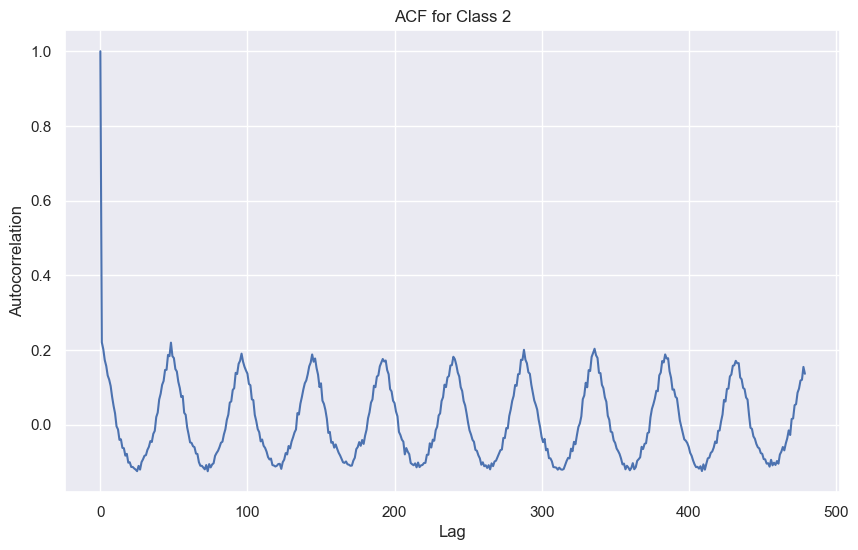

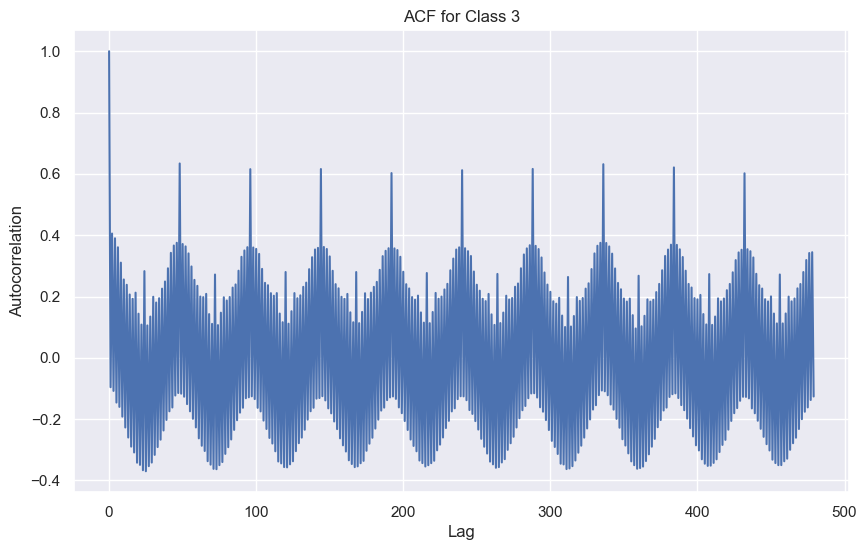

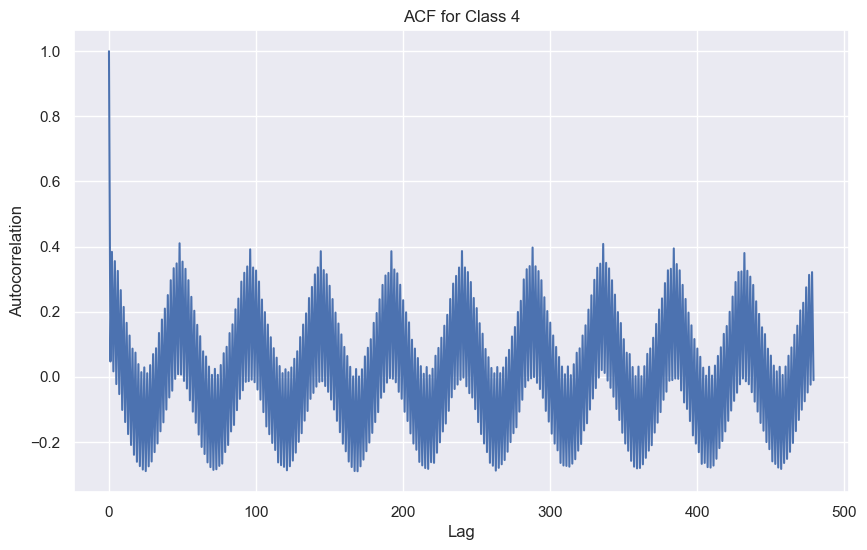

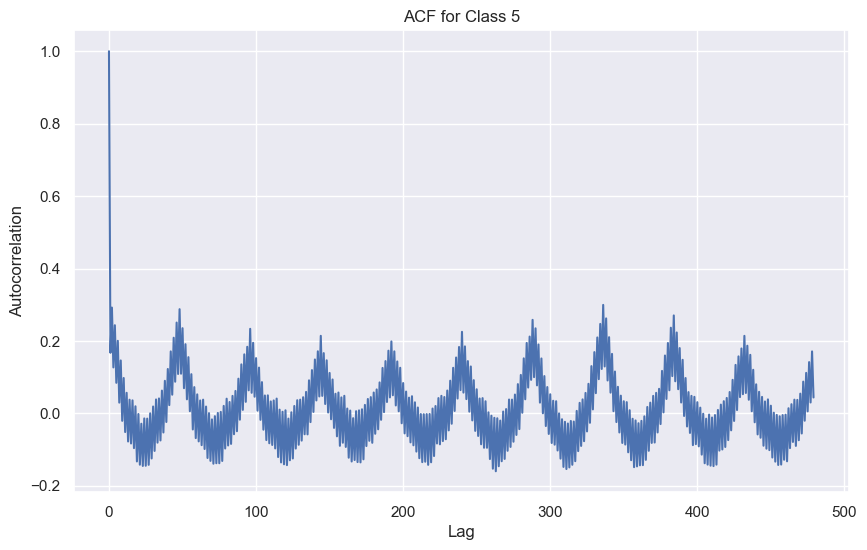

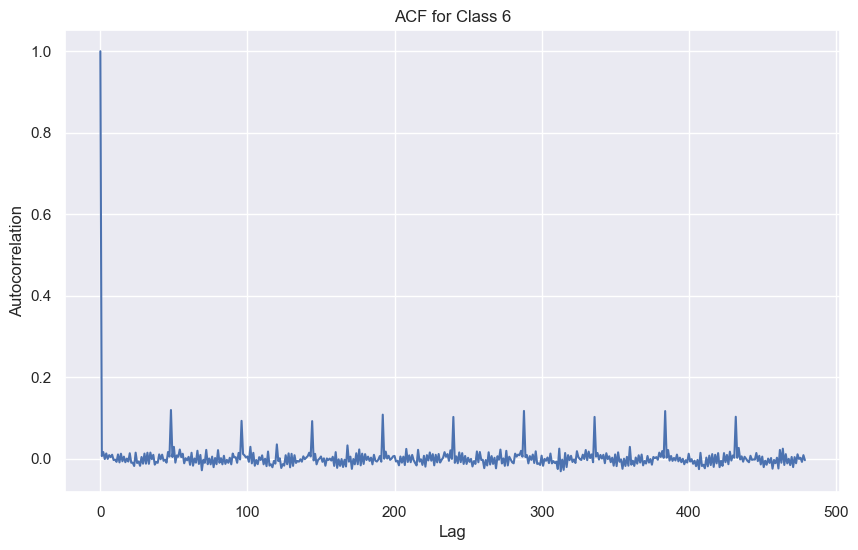

In [83]:
# Calculate the ACF for each class
classes_to_plot = range(7)
acf_per_class = {}

for class_value in classes_to_plot:
    # Filter data for the specific class and calculate the count for each date
    class_full = all_dates.merge(crime[crime['Class'] == class_value], on="Date", how = "left")
    summed_values = class_full.groupby('Date')['Class'].count()

    # Plot the values
    fig, ax = plt.subplots(figsize=(10, 6))
    acf = sm.tsa.stattools.acf(summed_values, nlags = len(summed_values)-1)
    acf_per_class[class_value] = acf

    plt.plot(acf[:480])#480 lags equals 2*24*10 is 10 days because we look at intervals of half an hour
    plt.title(f'ACF for Class {class_value}')
    plt.xlabel('Lag')
    plt.ylabel('Autocorrelation')
    plt.show()

acf_df = pd.DataFrame(acf_per_class)

In [84]:
acf_df.columns = ["0", "1", "2", "3", "4", "5", "6"]

In [85]:
peaks, _ = find_peaks(acf_df["1"], threshold=0.1)
peaks_difference = pd.Series(peaks[1:]).subtract(pd.Series(peaks[0:-1]))
peaks_difference.value_counts()

24     182
48      36
6       18
18      15
96       4
2        2
16       2
144      1
288      1
240      1
192      1
Name: count, dtype: int64

In [90]:
peaks, _ = find_peaks(acf_df["1"], height = 0.21)
print(peaks)
peaks_difference = pd.Series(peaks[1:]).subtract(pd.Series(peaks[0:-1]))
peaks_difference.value_counts()

[  48   96  240  288  336  384  672  720  768  960 1008 1296 1632 1680]


48     8
288    2
144    1
192    1
336    1
Name: count, dtype: int64

In [29]:
crime["Weekday"] = crime["Date"].dt.dayofweek

In [31]:
#add dates to acfs to merge with original df
acf_df["Date"] = all_dates
crime_acf = crime.merge(acf_df, on="Date", how="left")
crime_acf

#Extract values from Date for KNN
crime_acf['Month'] = pd.to_datetime(crime_acf['Date']).dt.month
crime_acf['Day'] = pd.to_datetime(crime_acf['Date']).dt.day
crime_acf['Hour'] = pd.to_datetime(crime_acf['Date']).dt.hour
crime_acf['Minute'] = pd.to_datetime(crime_acf['Date']).dt.minute

crime_acf

,ID,Case Number,Date,Block,IUCR,Primary Type,Description,Location Description,Arrest,Domestic,Beat,District,Ward,Community Area,FBI Code,X Coordinate,Y Coordinate,Year,Updated On,Latitude,Longitude,Location,Class,Weekday,0,1,2,3,4,5,6,Month,Day,Hour,Minute
0,13204489,JG416325,2023-09-06 11:00:00,0000X E 8TH ST,0810,THEFT,OVER $500,PARKING LOT / GARAGE (NON RESIDENTIAL),False,False,123,1,4.0,32,06,1176857.0,1896680.0,2023,11/04/2023 03:40:18 PM,41.871835,-87.626151,"(41.871834768, -87.62615082)",3,2,-0.000012,0.001898,-0.026953,0.018717,-0.000558,-0.002102,0.006250,9,6,11,0
1,13045102,JG226663,2023-03-30 09:30:00,080XX S DREXEL AVE,1544,SEX OFFENSE,SEXUAL EXPLOITATION OF A CHILD,APARTMENT,False,True,631,6,8.0,44,17,1183631.0,1851847.0,2023,09/14/2023 03:41:59 PM,41.748654,-87.602680,"(41.748653803, -87.602680492)",5,3,-0.000170,-0.073565,-0.074926,-0.257816,-0.202317,-0.099071,-0.015477,3,30,9,30
2,13074891,JG262771,2023-05-10 12:30:00,028XX N MANGO AVE,1754,OFFENSE INVOLVING CHILDREN,AGGRAVATED SEXUAL ASSAULT OF CHILD BY FAMILY M...,RESIDENCE,False,True,2514,25,30.0,19,02,1137557.0,1918320.0,2023,09/14/2023 03:41:59 PM,41.932015,-87.769917,"(41.932015426, -87.769916668)",6,2,-0.000131,-0.054677,-0.070052,-0.232335,-0.184905,-0.098248,-0.004457,5,10,12,30
3,13099339,JG291745,2023-04-01 11:00:00,020XX N LAPORTE AVE,1751,OFFENSE INVOLVING CHILDREN,CRIMINAL SEXUAL ABUSE BY FAMILY MEMBER,RESIDENCE,False,True,2522,25,26.0,19,17,1143059.0,1913090.0,2023,09/14/2023 03:41:59 PM,41.917563,-87.749828,"(41.917562778, -87.749828117)",6,5,-0.000171,-0.004536,-0.083267,0.082515,0.010314,-0.019562,-0.000228,4,1,11,0
4,13121127,JG313964,2023-06-22 19:00:00,015XX W NORTH AVE,1153,DECEPTIVE PRACTICE,FINANCIAL IDENTITY THEFT OVER $ 300,AUTO / BOAT / RV DEALERSHIP,True,False,1433,14,1.0,24,11,1165854.0,1910738.0,2023,09/14/2023 03:41:59 PM,41.910653,-87.666146,"(41.91065261, -87.66614577)",3,3,-0.000093,0.018184,0.000177,0.107692,0.071005,0.016781,-0.006927,6,22,19,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
242729,27322,JG131679,2023-01-27 14:00:00,095XX S BENNETT AVE,0110,HOMICIDE,FIRST DEGREE MURDER,HOUSE,True,True,431,4,7.0,51,01A,1190517.0,1842023.0,2023,02/08/2023 03:40:16 PM,41.721533,-87.577764,"(41.721532572, -87.577764122)",6,4,-0.000137,-0.004031,-0.087699,0.137915,0.035800,-0.001544,0.007077,1,27,14,0
242730,27334,JG145885,2023-02-08 23:30:00,025XX S WABASH AVE,0110,HOMICIDE,FIRST DEGREE MURDER,STREET,False,False,133,1,3.0,33,01A,1177151.0,1887463.0,2023,02/15/2023 03:41:05 PM,41.846536,-87.625350,"(41.846536062, -87.625350476)",6,2,-0.000144,0.034176,0.147600,-0.123988,-0.028393,0.043075,0.000194,2,8,23,30
242731,27435,JG224023,2023-04-15 07:30:00,005XX N LAMON AVE,0110,HOMICIDE,FIRST DEGREE MURDER,STREET,False,False,1532,15,37.0,25,01A,1143593.0,1903311.0,2023,04/22/2023 03:41:17 PM,41.890718,-87.748111,"(41.890718131, -87.74811127)",6,5,-0.000179,-0.058995,-0.047615,-0.208612,-0.138822,-0.070770,0.002153,4,15,7,30
242732,27289,JG107068,2023-01-06 21:30:00,056XX S THROOP ST,0110,HOMICIDE,FIRST DEGREE MURDER,HOUSE,True,False,713,7,16.0,67,01A,1168619.0,1867434.0,2023,04/13/2023 03:40:28 PM,41.791763,-87.657241,"(41.791763159, -87.657240734)",6,4,-0.000187,0.006194,0.104032,-0.157020,-0.031228,0.038864,0.004950,1,6,21,30


In [32]:
predictors = ["0", "1", "2", "3", "4", "5", "6", "Month", "Day", "Hour", "Minute", "Weekday"]

# Split data into train and test sets
X_train, X_test, y_train, y_test = train_test_split(crime_acf[predictors], crime_acf["Class"], test_size=0.2, random_state=42, stratify=crime_acf["Class"])

#scale variables, important for KNN
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.fit_transform(X_test)

In [ ]:
# # Initialize a KNN classifier
# knn_time = KNeighborsClassifier()  # You can adjust the number of neighbors

# #create a dictionary of all values we want to test for n_neighbors
# param_grid = {'n_neighbors': [5, 10, 20, 30, 45, 60, 75, 95, 120]}
# #use gridsearch to test all values for n_neighbors

# knn_gscv_time = GridSearchCV(knn_time, param_grid, cv=5, verbose=3)

# # Train the model
# start = time.time()
# knn_gscv_time.fit(X_train_scaled, y_train)
# end = time.time()
# print(f"Finished hyperparameter optimization in {round((end-start)/60, 2)} minutes")

# #check top performing n_neighbors value
# knn_gscv_time.best_params_

Fitting 5 folds for each of 9 candidates, totalling 45 fits


c:\Users\noord\Python\Lib\site-packages\sklearn\model_selection\_split.py:737: UserWarning: The least populated class in y has only 3 members, which is less than n_splits=5.
  warnings.warn(


[CV 1/5] END .....................n_neighbors=5;, score=0.368 total time=   7.9s
[CV 2/5] END .....................n_neighbors=5;, score=0.376 total time=   7.1s
[CV 3/5] END .....................n_neighbors=5;, score=0.371 total time=   9.4s


KeyboardInterrupt: 

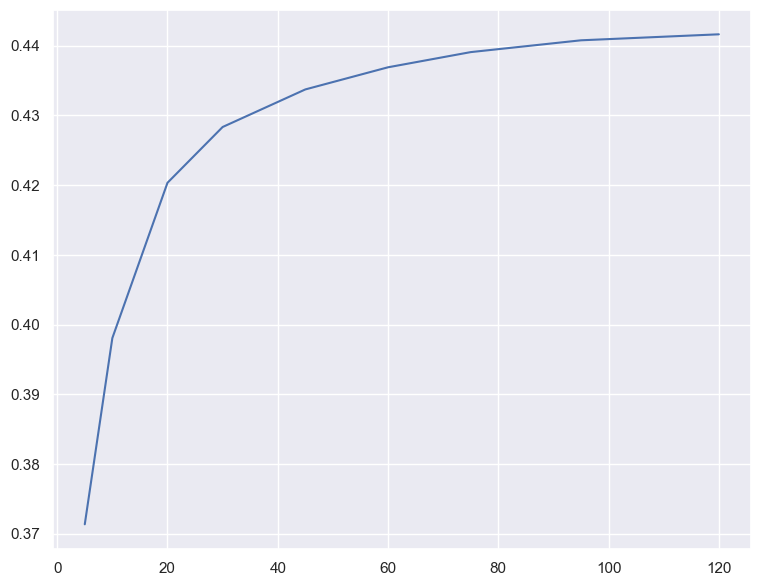

In [ ]:
# results_knn_t = pd.DataFrame(knn_gscv_time.cv_results_)
# plt.plot(results_knn_t["param_n_neighbors"], results_knn_t["mean_test_score"])

In [ ]:
# # define the xgb model
# xgb_time = XGBClassifier()

# # define grid
# param_grid = {
#     'max_depth': [3, 5],
#     'learning_rate': [0.1, 0.01],
#     'subsample': [0.5, 0.7],
#     'colsample_bytree': [0.6, 0.8]
# }

# # evaluate the model
# start = time.time()
# gs_xgb_time = GridSearchCV(xgb_time, param_grid, cv=5, scoring='accuracy', verbose = 3)
# end = time.time()
# print(f"Finished hyperparameter optimization in {round((end-start)/60, 2)} minutes")

# gs_xgb_time.fit(X_train_scaled, y_train)

# # report performance
# print("Best set of hyperparameters: ", gs_xgb_time.best_params_)
# print("Best score: ", gs_xgb_time.best_score_)

Finished hyperparameter optimization in 0.0 minutes
Fitting 5 folds for each of 16 candidates, totalling 80 fits


c:\Users\noord\Python\Lib\site-packages\sklearn\model_selection\_split.py:737: UserWarning: The least populated class in y has only 3 members, which is less than n_splits=5.
  warnings.warn(


[CV 1/5] END colsample_bytree=0.6, learning_rate=0.1, max_depth=3, subsample=0.5;, score=0.444 total time=  15.1s
[CV 2/5] END colsample_bytree=0.6, learning_rate=0.1, max_depth=3, subsample=0.5;, score=0.444 total time=  12.5s
[CV 3/5] END colsample_bytree=0.6, learning_rate=0.1, max_depth=3, subsample=0.5;, score=0.444 total time=  10.5s
[CV 4/5] END colsample_bytree=0.6, learning_rate=0.1, max_depth=3, subsample=0.5;, score=0.444 total time=   9.9s


KeyboardInterrupt: 

In [ ]:
# predict test set using best model according to validation
xgb_time_best = XGBClassifier(learning_rate= 0.001, max_depth= 5, subsample=0.5)
xgb_time_best.fit(X_train, y_train)
y_pred = xgb_time_best.predict(X_test)

# Evaluate the model
accuracy = accuracy_score(y_test, y_pred)
precision = precision_score(y_test, y_pred, average=None)
recall = recall_score(y_test, y_pred, average=None)

print(f'Accuracy: {accuracy}')
print(f'Precision: {precision}')
print(f'Recall: {recall}')

Accuracy: 0.4443734937277278
Precision: [0.         0.         0.44455452 0.         0.35483871 0.        ]
Recall: [0.         0.         0.9985166  0.         0.00375171 0.        ]


c:\Users\noord\Python\Lib\site-packages\sklearn\metrics\_classification.py:1471: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


## Spatial patterns 

<Axes: xlabel='Longitude', ylabel='Latitude'>

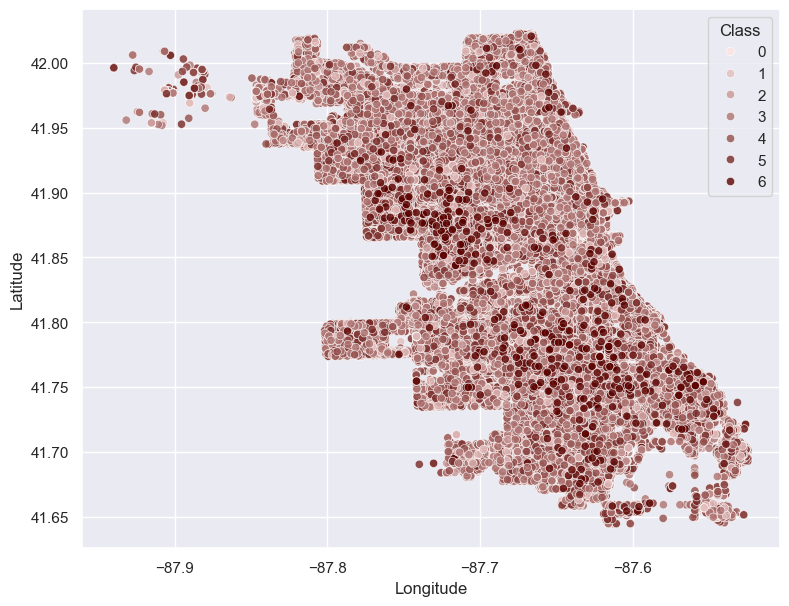

In [33]:
sb.set(rc={'figure.figsize':(9,7)})
pal = sb.color_palette("blend:#ffe3e2,#5b0300", n_colors=7)
sb.scatterplot(data=crime, y="Latitude", x="Longitude", hue = "Class", alpha = 0.8, palette=pal)

In [34]:
beat_shp = 'geo_export_a2a5b441-db14-459c-a368-f3efe6e02f54.shp'
beat = gpd.read_file(beat_shp)
beat = beat.sort_values("beat_num")
beat # Three duplicate values beats that encompass three different areas

,beat,beat_num,district,sector,geometry
87,1,0111,01,1,"POLYGON ((-87.62451 41.88830, -87.62454 41.888..."
92,1,0112,01,1,"POLYGON ((-87.62534 41.88322, -87.62532 41.883..."
125,1,0113,01,1,"POLYGON ((-87.62613 41.87952, -87.62608 41.879..."
86,1,0114,01,1,"POLYGON ((-87.62437 41.88886, -87.62419 41.888..."
90,2,0121,01,2,"POLYGON ((-87.63773 41.88572, -87.63776 41.885..."
...,...,...,...,...,...
193,3,2534,25,3,"POLYGON ((-87.72656 41.91717, -87.72655 41.917..."
192,3,2535,25,3,"POLYGON ((-87.71677 41.91728, -87.71677 41.917..."
263,0,3100,31,0,"POLYGON ((-87.69123 41.69899, -87.69123 41.698..."
1,0,3100,31,0,"POLYGON ((-87.83365 41.97535, -87.83366 41.974..."


<Axes: >

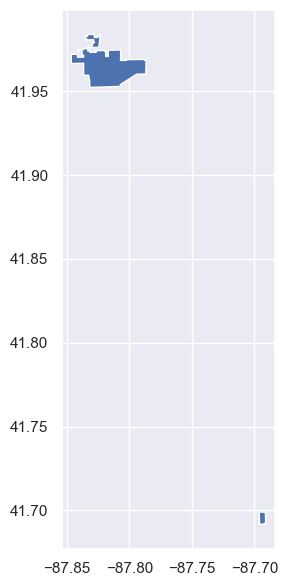

In [35]:
beat.iloc[np.r_[274:277]].plot()

<Axes: >

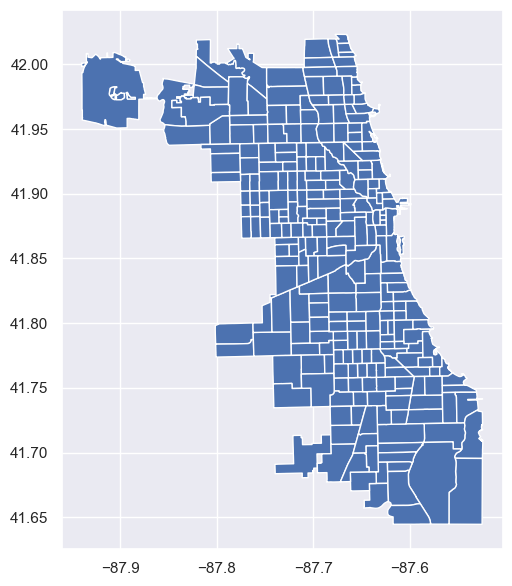

In [36]:
beat.iloc[np.r_[:274, 275]].plot() #index 274 and 276 only encompass small areas we will ignore those

In [37]:
beat_no_dup = beat.iloc[np.r_[:274, 275]]
beat_no_dup

,beat,beat_num,district,sector,geometry
87,1,0111,01,1,"POLYGON ((-87.62451 41.88830, -87.62454 41.888..."
92,1,0112,01,1,"POLYGON ((-87.62534 41.88322, -87.62532 41.883..."
125,1,0113,01,1,"POLYGON ((-87.62613 41.87952, -87.62608 41.879..."
86,1,0114,01,1,"POLYGON ((-87.62437 41.88886, -87.62419 41.888..."
90,2,0121,01,2,"POLYGON ((-87.63773 41.88572, -87.63776 41.885..."
...,...,...,...,...,...
144,3,2532,25,3,"POLYGON ((-87.76076 41.91502, -87.75587 41.915..."
194,3,2533,25,3,"POLYGON ((-87.73633 41.91704, -87.73632 41.916..."
193,3,2534,25,3,"POLYGON ((-87.72656 41.91717, -87.72655 41.917..."
192,3,2535,25,3,"POLYGON ((-87.71677 41.91728, -87.71677 41.917..."


In [38]:
beat_no_dup.to_file('chicago_beats_no_duplicates.shp')
beat_no_dup_shp = 'chicago_beats_no_duplicates.shp'

In [39]:
crime[crime[["Beat"]].isna().any(axis=1)]

,ID,Case Number,Date,Block,IUCR,Primary Type,Description,Location Description,Arrest,Domestic,Beat,District,Ward,Community Area,FBI Code,X Coordinate,Y Coordinate,Year,Updated On,Latitude,Longitude,Location,Class,Weekday


In [40]:
print((beat["beat_num"].unique()))
crime["Beat"].unique()

['0111' '0112' '0113' '0114' '0121' '0122' '0123' '0124' '0131' '0132'
 '0133' '0211' '0212' '0213' '0214' '0215' '0221' '0222' '0223' '0224'
 '0225' '0231' '0232' '0233' '0234' '0235' '0311' '0312' '0313' '0314'
 '0321' '0322' '0323' '0324' '0331' '0332' '0333' '0334' '0411' '0412'
 '0413' '0414' '0421' '0422' '0423' '0424' '0431' '0432' '0433' '0434'
 '0511' '0512' '0513' '0522' '0523' '0524' '0531' '0532' '0533' '0611'
 '0612' '0613' '0614' '0621' '0622' '0623' '0624' '0631' '0632' '0633'
 '0634' '0711' '0712' '0713' '0714' '0715' '0722' '0723' '0724' '0725'
 '0726' '0731' '0732' '0733' '0734' '0735' '0811' '0812' '0813' '0814'
 '0815' '0821' '0822' '0823' '0824' '0825' '0831' '0832' '0833' '0834'
 '0835' '0911' '0912' '0913' '0914' '0915' '0921' '0922' '0923' '0924'
 '0925' '0931' '0932' '0933' '0934' '0935' '1011' '1012' '1013' '1014'
 '1021' '1022' '1023' '1024' '1031' '1032' '1033' '1034' '1111' '1112'
 '1113' '1114' '1115' '1121' '1122' '1123' '1124' '1125' '1131' '1132'
 '1133

array([ 123,  631, 2514, 2522, 1433,  531,  224,  232, 1431, 1412, 1421,
       1432, 1424, 1712, 1422,  833, 2512, 2532, 2524,  621,  432, 2533,
        831, 1622,  822, 1634, 2515, 1021,  815,  824, 1731, 1423,  925,
        613,  835,  722, 1235,  133,  914, 2521, 1713, 1914,  412,  731,
       1511, 1611, 2013,  222,  322, 1533, 1115,  434, 2534, 1214, 2032,
        132,  825,  122,  421, 1135,  823, 1523,  215, 2024,  633, 2234,
       1225,  611, 2031, 1623, 1133, 1911,  712,  313, 1913,  433, 1524,
       1012, 1915,  734,  632,  522,  124,  211,  331, 2413, 1134, 1650,
        431, 2423,  221,  512, 1733, 1821, 1921, 2221,  634,  411,  414,
       2432,  114, 2433, 1112, 1925, 1832,  834,  832, 1922,  422, 2211,
       1824, 2223,  915,  624, 1931, 2525, 1113, 1833, 1631, 1121, 1655,
        821, 1522,  726, 2411, 2431, 1114,  614, 1213,  523,  934,  724,
        312,  423, 1122, 1414,  225,  524,  732, 1123, 2011, 1811, 1711,
        932, 1234,  612, 1224, 1724,  532, 1831,  3

In [41]:
crime["Beat"] = crime["Beat"].apply(str)
crime["Beat"]

0          123
1          631
2         2514
3         2522
4         1433
          ... 
242729     431
242730     133
242731    1532
242732     713
242733    1133
Name: Beat, Length: 242734, dtype: object

In [42]:
set(beat["beat_num"].unique()).difference(set(crime["Beat"].unique()))

{'0111',
 '0112',
 '0113',
 '0114',
 '0121',
 '0122',
 '0123',
 '0124',
 '0131',
 '0132',
 '0133',
 '0211',
 '0212',
 '0213',
 '0214',
 '0215',
 '0221',
 '0222',
 '0223',
 '0224',
 '0225',
 '0231',
 '0232',
 '0233',
 '0234',
 '0235',
 '0311',
 '0312',
 '0313',
 '0314',
 '0321',
 '0322',
 '0323',
 '0324',
 '0331',
 '0332',
 '0333',
 '0334',
 '0411',
 '0412',
 '0413',
 '0414',
 '0421',
 '0422',
 '0423',
 '0424',
 '0431',
 '0432',
 '0433',
 '0434',
 '0511',
 '0512',
 '0513',
 '0522',
 '0523',
 '0524',
 '0531',
 '0532',
 '0533',
 '0611',
 '0612',
 '0613',
 '0614',
 '0621',
 '0622',
 '0623',
 '0624',
 '0631',
 '0632',
 '0633',
 '0634',
 '0711',
 '0712',
 '0713',
 '0714',
 '0715',
 '0722',
 '0723',
 '0724',
 '0725',
 '0726',
 '0731',
 '0732',
 '0733',
 '0734',
 '0735',
 '0811',
 '0812',
 '0813',
 '0814',
 '0815',
 '0821',
 '0822',
 '0823',
 '0824',
 '0825',
 '0831',
 '0832',
 '0833',
 '0834',
 '0835',
 '0911',
 '0912',
 '0913',
 '0914',
 '0915',
 '0921',
 '0922',
 '0923',
 '0924',
 '0925',
 

In [43]:
# Function to add a leading zero if the string has only 3 characters
def add_zero_if_three_digits(value):
    if len(value) == 3:
        value = '0' + value
    return value

add_zero_if_three_digits('555')

# Apply the function to the column
crime["Beat"] = crime['Beat'].apply(add_zero_if_three_digits)
crime["Beat"]

0         0123
1         0631
2         2514
3         2522
4         1433
          ... 
242729    0431
242730    0133
242731    1532
242732    0713
242733    1133
Name: Beat, Length: 242734, dtype: object

In [44]:
w_queen = ps.weights.Queen.from_shapefile(beat_no_dup_shp, idVariable="beat_num")
w_queen

c:\Users\noord\Python\Lib\site-packages\libpysal\cg\shapes.py:1394: FutureWarning: Objects based on the `Geometry` class will deprecated and removed in a future version of libpysal.
  warnings.warn(dep_msg, FutureWarning)
c:\Users\noord\Python\Lib\site-packages\libpysal\cg\shapes.py:1123: FutureWarning: Objects based on the `Geometry` class will deprecated and removed in a future version of libpysal.
  warnings.warn(dep_msg, FutureWarning)


In [45]:
w_queen['1031']

{'0821': 1.0, '1013': 1.0, '1032': 1.0, '0815': 1.0, '0814': 1.0}

In [46]:
queen_card = pd.Series(w_queen.cardinalities)
queen_card.head()

0111    5
0112    4
0113    4
0114    7
0121    6
dtype: int64

In [47]:
# Row-standardize the queen matrix
w_queen.transform = 'R'

In [48]:
crime_beat = crime.merge(beat_no_dup, left_on="Beat", right_on="beat_num", how = "right")
crime_beat

,ID,Case Number,Date,Block,IUCR,Primary Type,Description,Location Description,Arrest,Domestic,Beat,District,Ward,Community Area,FBI Code,X Coordinate,Y Coordinate,Year,Updated On,Latitude,Longitude,Location,Class,Weekday,beat,beat_num,district,sector,geometry
0,13201508.0,JG413401,2023-09-06 06:00:00,0000X E WACKER DR,0560,ASSAULT,SIMPLE,RESTAURANT,False,False,0111,1.0,42.0,32.0,08A,1176994.0,1902568.0,2023.0,09/14/2023 03:43:09 PM,41.887989,-87.625470,"(41.887988672, -87.625469546)",4.0,2.0,1,0111,01,1,"POLYGON ((-87.62451 41.88830, -87.62454 41.888..."
1,13201996.0,JG414004,2023-09-06 17:30:00,001XX N STATE ST,0860,THEFT,RETAIL THEFT,DEPARTMENT STORE,True,False,0111,1.0,34.0,32.0,06,1176352.0,1900927.0,2023.0,09/14/2023 03:43:09 PM,41.883500,-87.627877,"(41.883500187, -87.627876698)",3.0,2.0,1,0111,01,1,"POLYGON ((-87.62451 41.88830, -87.62454 41.888..."
2,13194233.0,JG404487,2023-08-30 19:30:00,001XX N STATE ST,0850,THEFT,ATTEMPT THEFT,SMALL RETAIL STORE,True,False,0111,1.0,42.0,32.0,06,1176338.0,1901346.0,2023.0,09/15/2023 03:41:25 PM,41.884650,-87.627915,"(41.884650262, -87.627915459)",3.0,2.0,1,0111,01,1,"POLYGON ((-87.62451 41.88830, -87.62454 41.888..."
3,13207678.0,JG420016,2023-08-21 11:30:00,001XX N WABASH AVE,0810,THEFT,OVER $500,SMALL RETAIL STORE,False,False,0111,1.0,34.0,32.0,06,1176799.0,1900994.0,2023.0,09/15/2023 03:41:25 PM,41.883674,-87.626233,"(41.883673944, -87.626233272)",3.0,0.0,1,0111,01,1,"POLYGON ((-87.62451 41.88830, -87.62454 41.888..."
4,13203180.0,JG415438,2023-09-07 19:30:00,001XX N STATE ST,2093,NARCOTICS,FOUND SUSPECT NARCOTICS,CTA PLATFORM,True,False,0111,1.0,42.0,32.0,18,1176330.0,1901649.0,2023.0,09/15/2023 03:42:23 PM,41.885482,-87.627936,"(41.885481891, -87.627935689)",2.0,3.0,1,0111,01,1,"POLYGON ((-87.62451 41.88830, -87.62454 41.888..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
242649,13182245.0,JG390472,2023-08-19 14:00:00,014XX N AVERS AVE,0890,THEFT,FROM BUILDING,ALLEY,False,False,2535,25.0,26.0,23.0,06,1150447.0,1909305.0,2023.0,08/27/2023 03:43:14 PM,41.907035,-87.722783,"(41.907035236, -87.722783146)",3.0,5.0,3,2535,25,3,"POLYGON ((-87.71677 41.91728, -87.71677 41.917..."
242650,13082375.0,JG272123,2023-05-23 06:30:00,017XX N CENTRAL PARK AVE,2825,OTHER OFFENSE,HARASSMENT BY TELEPHONE,RESIDENCE,False,True,2535,25.0,26.0,23.0,26,1152108.0,1911337.0,2023.0,08/19/2023 03:40:26 PM,41.912579,-87.716628,"(41.912578627, -87.716627879)",1.0,1.0,3,2535,25,3,"POLYGON ((-87.71677 41.91728, -87.71677 41.917..."
242651,27556.0,JG296336,2023-06-11 01:30:00,037XX W DIVISION ST,0110,HOMICIDE,FIRST DEGREE MURDER,STREET,False,False,2535,25.0,36.0,23.0,01A,1151394.0,1907743.0,2023.0,06/18/2023 03:41:48 PM,41.902730,-87.719345,"(41.902730408, -87.719345458)",6.0,6.0,3,2535,25,3,"POLYGON ((-87.71677 41.91728, -87.71677 41.917..."
242652,27657.0,JG359289,2023-07-28 11:00:00,037XX W GRAND AVE,0110,HOMICIDE,FIRST DEGREE MURDER,PORCH,True,False,2535,25.0,36.0,23.0,01A,1151102.0,1908122.0,2023.0,08/04/2023 03:41:47 PM,41.903776,-87.720408,"(41.903776151, -87.720408087)",6.0,4.0,3,2535,25,3,"POLYGON ((-87.71677 41.91728, -87.71677 41.917..."


In [49]:
len(crime_beat["beat_num"].unique())

275

In [50]:
beat_no_dup

,beat,beat_num,district,sector,geometry
87,1,0111,01,1,"POLYGON ((-87.62451 41.88830, -87.62454 41.888..."
92,1,0112,01,1,"POLYGON ((-87.62534 41.88322, -87.62532 41.883..."
125,1,0113,01,1,"POLYGON ((-87.62613 41.87952, -87.62608 41.879..."
86,1,0114,01,1,"POLYGON ((-87.62437 41.88886, -87.62419 41.888..."
90,2,0121,01,2,"POLYGON ((-87.63773 41.88572, -87.63776 41.885..."
...,...,...,...,...,...
144,3,2532,25,3,"POLYGON ((-87.76076 41.91502, -87.75587 41.915..."
194,3,2533,25,3,"POLYGON ((-87.73633 41.91704, -87.73632 41.916..."
193,3,2534,25,3,"POLYGON ((-87.72656 41.91717, -87.72655 41.917..."
192,3,2535,25,3,"POLYGON ((-87.71677 41.91728, -87.71677 41.917..."


In [51]:
# Count occurrences per beat and crime class
beat_class_counts = crime_beat.groupby(['beat_num', 'Class']).size().reset_index(name='crime_count')

# Pivot the table to have crime classes as columns
beat_class_counts_pivot = beat_class_counts.pivot(index='beat_num', columns='Class', values='crime_count').reset_index()
beat_class_counts_pivot.columns.name = None
beat_class_counts_pivot.loc[len(beat_class_counts_pivot)] = ['3100', 0, 0, 0, 0, 0, 0, 0]

# Fill NaN values with 0
beat_class_counts_pivot = beat_class_counts_pivot.fillna(0)

# # Melt the pivoted table back to the original format
beat_class_counts = beat_class_counts_pivot.melt(id_vars='beat_num', var_name='Class', value_name='crime_count')

# # Sort data frame
beat_class_counts = beat_class_counts.sort_values(by=['beat_num', 'Class']).reset_index(drop=True)
beat_class_counts

# # Merge with original beat_crime
beat_class_counts = beat_class_counts.merge(beat_no_dup, on=["beat_num"], how="right")
beat_class_counts

,beat_num,Class,crime_count,beat,district,sector,geometry
0,0111,0.0,0.0,1,01,1,"POLYGON ((-87.62451 41.88830, -87.62454 41.888..."
1,0111,1.0,43.0,1,01,1,"POLYGON ((-87.62451 41.88830, -87.62454 41.888..."
2,0111,2.0,55.0,1,01,1,"POLYGON ((-87.62451 41.88830, -87.62454 41.888..."
3,0111,3.0,1121.0,1,01,1,"POLYGON ((-87.62451 41.88830, -87.62454 41.888..."
4,0111,4.0,164.0,1,01,1,"POLYGON ((-87.62451 41.88830, -87.62454 41.888..."
...,...,...,...,...,...,...,...
1920,3100,2.0,0.0,0,31,0,"POLYGON ((-87.83365 41.97535, -87.83366 41.974..."
1921,3100,3.0,0.0,0,31,0,"POLYGON ((-87.83365 41.97535, -87.83366 41.974..."
1922,3100,4.0,0.0,0,31,0,"POLYGON ((-87.83365 41.97535, -87.83366 41.974..."
1923,3100,5.0,0.0,0,31,0,"POLYGON ((-87.83365 41.97535, -87.83366 41.974..."


In [52]:
beat_class_counts = gpd.GeoDataFrame(beat_class_counts)

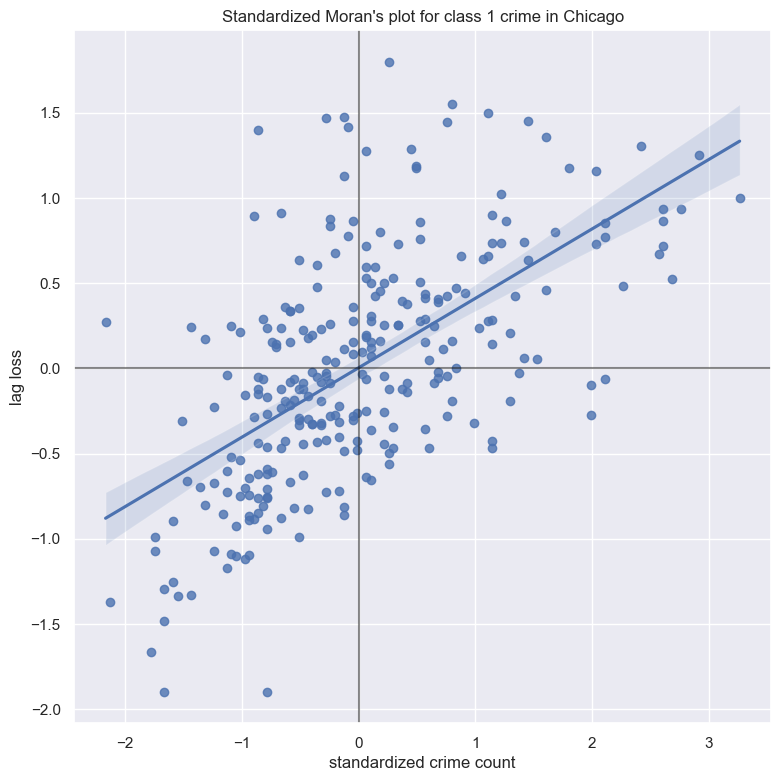

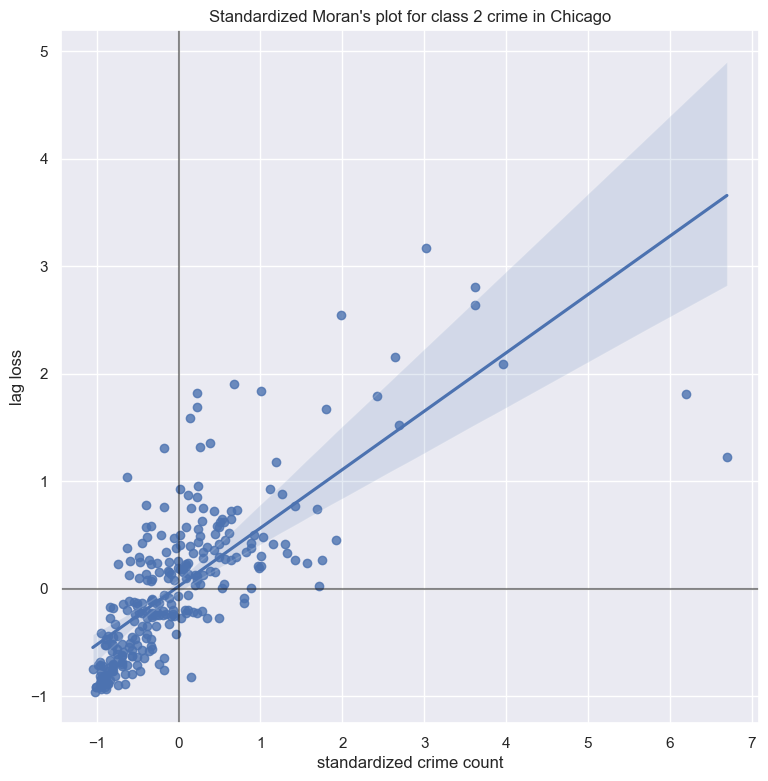

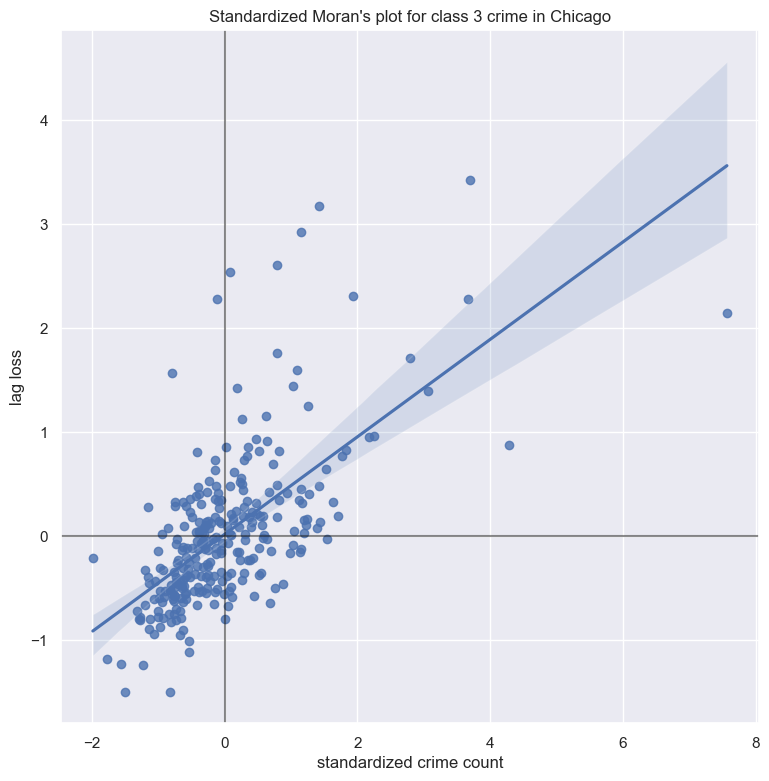

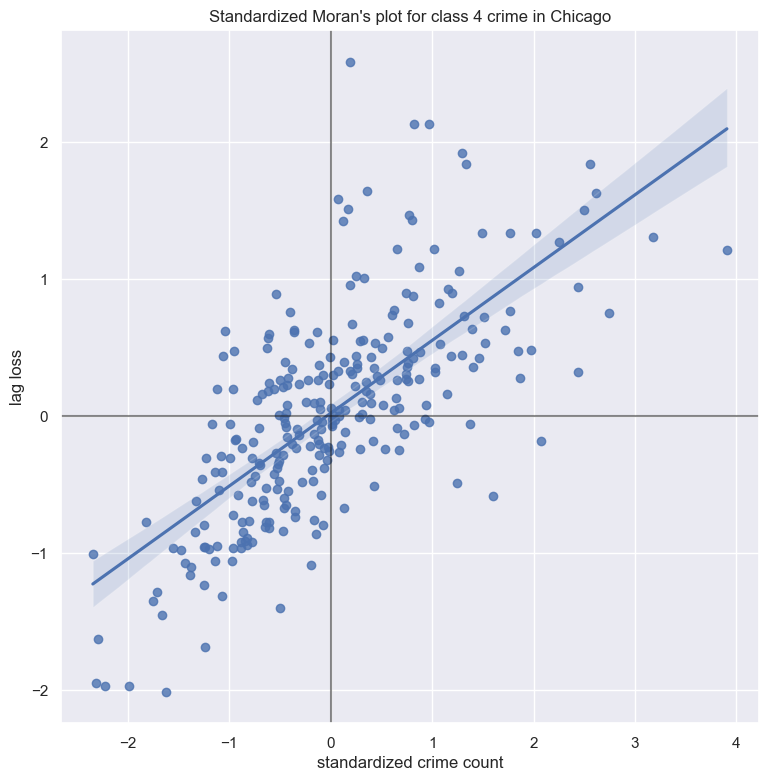

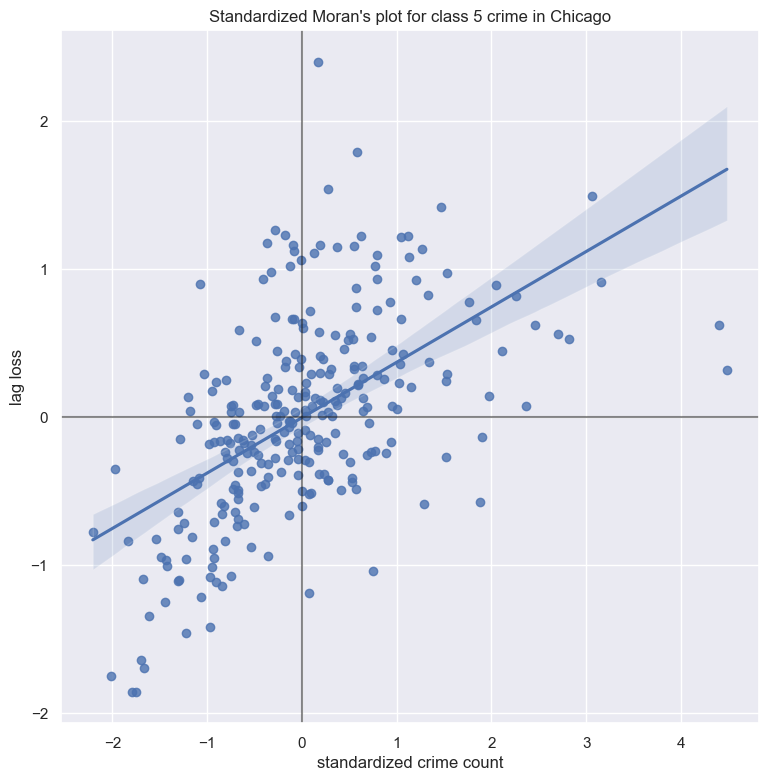

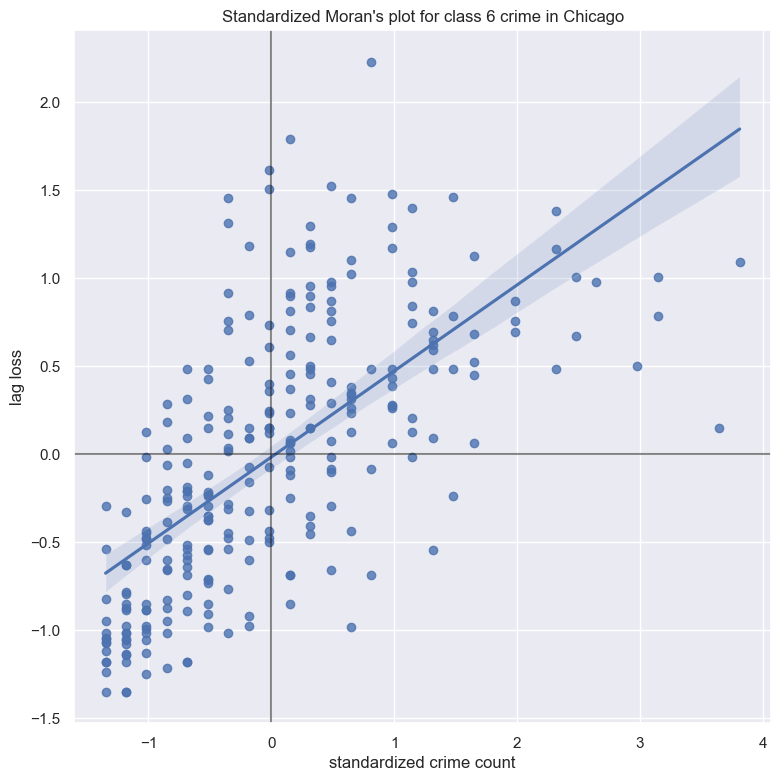

In [53]:
for target in range(1,7):
    df = beat_class_counts[beat_class_counts["Class"] == target]
    std_loss = (df["crime_count"] - df["crime_count"].mean())/df["crime_count"].std()

    f, ax = plt.subplots(1, figsize=(9, 9))

    std_w_score_loss = ps.weights.lag_spatial(w_queen, std_loss)

    sb.regplot(x=std_loss, y=std_w_score_loss).set(title = f"Standardized Moran's plot for class {target} crime in Chicago")

    ax.set_xlabel(f"standardized crime count")
    ax.set_ylabel("lag loss")
    # Add vertical and horizontal lines
    plt.axvline(0, c='k', alpha=0.5)
    plt.axhline(0, c='k', alpha=0.5)
    # Display
    plt.show()

In [54]:
beat_class_counts[beat_class_counts["Class"] == 1].explore(column="crime_count", cmap = "Reds", tooltip = ["beat_num", "crime_count"])

In [55]:
beat_class_counts[beat_class_counts["Class"] == 2].explore(column="crime_count", cmap = "Reds", tooltip = ["beat_num", "crime_count"])

In [56]:
beat_class_counts[beat_class_counts["Class"] == 3].explore(column="crime_count", cmap = "Reds", tooltip = ["beat_num", "crime_count"])

In [57]:
beat_class_counts[beat_class_counts["Class"] == 4].explore(column="crime_count", cmap = "Reds", tooltip = ["beat_num", "crime_count"])

In [58]:
beat_class_counts[beat_class_counts["Class"] == 5].explore(column="crime_count", cmap = "Reds", tooltip = ["beat_num", "crime_count"])

In [59]:
beat_class_counts[beat_class_counts["Class"] == 6].explore(column="crime_count", cmap = "Reds", tooltip = ["beat_num", "crime_count"])

In [60]:
crime.head()

,ID,Case Number,Date,Block,IUCR,Primary Type,Description,Location Description,Arrest,Domestic,Beat,District,Ward,Community Area,FBI Code,X Coordinate,Y Coordinate,Year,Updated On,Latitude,Longitude,Location,Class,Weekday
0,13204489,JG416325,2023-09-06 11:00:00,0000X E 8TH ST,0810,THEFT,OVER $500,PARKING LOT / GARAGE (NON RESIDENTIAL),False,False,0123,1,4.0,32,06,1176857.0,1896680.0,2023,11/04/2023 03:40:18 PM,41.871835,-87.626151,"(41.871834768, -87.62615082)",3,2
1,13045102,JG226663,2023-03-30 09:30:00,080XX S DREXEL AVE,1544,SEX OFFENSE,SEXUAL EXPLOITATION OF A CHILD,APARTMENT,False,True,0631,6,8.0,44,17,1183631.0,1851847.0,2023,09/14/2023 03:41:59 PM,41.748654,-87.602680,"(41.748653803, -87.602680492)",5,3
2,13074891,JG262771,2023-05-10 12:30:00,028XX N MANGO AVE,1754,OFFENSE INVOLVING CHILDREN,AGGRAVATED SEXUAL ASSAULT OF CHILD BY FAMILY M...,RESIDENCE,False,True,2514,25,30.0,19,02,1137557.0,1918320.0,2023,09/14/2023 03:41:59 PM,41.932015,-87.769917,"(41.932015426, -87.769916668)",6,2
3,13099339,JG291745,2023-04-01 11:00:00,020XX N LAPORTE AVE,1751,OFFENSE INVOLVING CHILDREN,CRIMINAL SEXUAL ABUSE BY FAMILY MEMBER,RESIDENCE,False,True,2522,25,26.0,19,17,1143059.0,1913090.0,2023,09/14/2023 03:41:59 PM,41.917563,-87.749828,"(41.917562778, -87.749828117)",6,5
4,13121127,JG313964,2023-06-22 19:00:00,015XX W NORTH AVE,1153,DECEPTIVE PRACTICE,FINANCIAL IDENTITY THEFT OVER $ 300,AUTO / BOAT / RV DEALERSHIP,True,False,1433,14,1.0,24,11,1165854.0,1910738.0,2023,09/14/2023 03:41:59 PM,41.910653,-87.666146,"(41.91065261, -87.66614577)",3,3


In [63]:
# Split data into train and test sets
X_train, X_test, y_train, y_test = train_test_split(crime["Beat"], crime["Class"], test_size=0.2, random_state=42)

In [62]:
# Initialize a KNN classifier
knn_space = KNeighborsClassifier()  

#create a dictionary of all values we want to test for n_neighbors
param_grid = {'n_neighbors': [5, 10, 20, 30, 45, 60, 75, 95, 120]}
#use gridsearch to test all values for n_neighbors

knn_gscv_space = GridSearchCV(knn_space, param_grid, cv=5, verbose=3)

# Train the model
start = time.time()
knn_gscv_space.fit(X_train, y_train)
end = time.time()
print(f"Finished hyperparameter optimization in {round((end-start)/60, 2)} minutes")

#check top performing n_neighbors value
knn_gscv_space.best_params_

Fitting 5 folds for each of 9 candidates, totalling 45 fits


c:\Users\noord\Python\Lib\site-packages\sklearn\model_selection\_split.py:737: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(


[CV 1/5] END .......................n_neighbors=5;, score=nan total time=   0.0s
[CV 2/5] END .......................n_neighbors=5;, score=nan total time=   0.0s
[CV 3/5] END .......................n_neighbors=5;, score=nan total time=   0.0s
[CV 4/5] END .......................n_neighbors=5;, score=nan total time=   0.0s
[CV 5/5] END .......................n_neighbors=5;, score=nan total time=   0.0s
[CV 1/5] END ......................n_neighbors=10;, score=nan total time=   0.0s
[CV 2/5] END ......................n_neighbors=10;, score=nan total time=   0.0s
[CV 3/5] END ......................n_neighbors=10;, score=nan total time=   0.0s
[CV 4/5] END ......................n_neighbors=10;, score=nan total time=   0.0s
[CV 5/5] END ......................n_neighbors=10;, score=nan total time=   0.0s
[CV 1/5] END ......................n_neighbors=20;, score=nan total time=   0.0s
[CV 2/5] END ......................n_neighbors=20;, score=nan total time=   0.0s
[CV 3/5] END ...............

ValueError: 
All the 45 fits failed.
It is very likely that your model is misconfigured.
You can try to debug the error by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
9 fits failed with the following error:
Traceback (most recent call last):
  File "c:\Users\noord\Python\Lib\site-packages\sklearn\model_selection\_validation.py", line 729, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "c:\Users\noord\Python\Lib\site-packages\sklearn\base.py", line 1152, in wrapper
    return fit_method(estimator, *args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "c:\Users\noord\Python\Lib\site-packages\sklearn\neighbors\_classification.py", line 233, in fit
    return self._fit(X, y)
           ^^^^^^^^^^^^^^^
  File "c:\Users\noord\Python\Lib\site-packages\sklearn\neighbors\_base.py", line 456, in _fit
    X, y = self._validate_data(
           ^^^^^^^^^^^^^^^^^^^^
  File "c:\Users\noord\Python\Lib\site-packages\sklearn\base.py", line 622, in _validate_data
    X, y = check_X_y(X, y, **check_params)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "c:\Users\noord\Python\Lib\site-packages\sklearn\utils\validation.py", line 1146, in check_X_y
    X = check_array(
        ^^^^^^^^^^^^
  File "c:\Users\noord\Python\Lib\site-packages\sklearn\utils\validation.py", line 938, in check_array
    raise ValueError(
ValueError: Expected 2D array, got 1D array instead:
array=[ 334. 2232.  634. ... 1121.  424.  215.].
Reshape your data either using array.reshape(-1, 1) if your data has a single feature or array.reshape(1, -1) if it contains a single sample.

--------------------------------------------------------------------------------
27 fits failed with the following error:
Traceback (most recent call last):
  File "c:\Users\noord\Python\Lib\site-packages\sklearn\model_selection\_validation.py", line 729, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "c:\Users\noord\Python\Lib\site-packages\sklearn\base.py", line 1152, in wrapper
    return fit_method(estimator, *args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "c:\Users\noord\Python\Lib\site-packages\sklearn\neighbors\_classification.py", line 233, in fit
    return self._fit(X, y)
           ^^^^^^^^^^^^^^^
  File "c:\Users\noord\Python\Lib\site-packages\sklearn\neighbors\_base.py", line 456, in _fit
    X, y = self._validate_data(
           ^^^^^^^^^^^^^^^^^^^^
  File "c:\Users\noord\Python\Lib\site-packages\sklearn\base.py", line 622, in _validate_data
    X, y = check_X_y(X, y, **check_params)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "c:\Users\noord\Python\Lib\site-packages\sklearn\utils\validation.py", line 1146, in check_X_y
    X = check_array(
        ^^^^^^^^^^^^
  File "c:\Users\noord\Python\Lib\site-packages\sklearn\utils\validation.py", line 938, in check_array
    raise ValueError(
ValueError: Expected 2D array, got 1D array instead:
array=[ 925. 1925. 1114. ... 1121.  424.  215.].
Reshape your data either using array.reshape(-1, 1) if your data has a single feature or array.reshape(1, -1) if it contains a single sample.

--------------------------------------------------------------------------------
9 fits failed with the following error:
Traceback (most recent call last):
  File "c:\Users\noord\Python\Lib\site-packages\sklearn\model_selection\_validation.py", line 729, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "c:\Users\noord\Python\Lib\site-packages\sklearn\base.py", line 1152, in wrapper
    return fit_method(estimator, *args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "c:\Users\noord\Python\Lib\site-packages\sklearn\neighbors\_classification.py", line 233, in fit
    return self._fit(X, y)
           ^^^^^^^^^^^^^^^
  File "c:\Users\noord\Python\Lib\site-packages\sklearn\neighbors\_base.py", line 456, in _fit
    X, y = self._validate_data(
           ^^^^^^^^^^^^^^^^^^^^
  File "c:\Users\noord\Python\Lib\site-packages\sklearn\base.py", line 622, in _validate_data
    X, y = check_X_y(X, y, **check_params)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "c:\Users\noord\Python\Lib\site-packages\sklearn\utils\validation.py", line 1146, in check_X_y
    X = check_array(
        ^^^^^^^^^^^^
  File "c:\Users\noord\Python\Lib\site-packages\sklearn\utils\validation.py", line 938, in check_array
    raise ValueError(
ValueError: Expected 2D array, got 1D array instead:
array=[ 925. 1925. 1114. ... 1724. 2512. 2221.].
Reshape your data either using array.reshape(-1, 1) if your data has a single feature or array.reshape(1, -1) if it contains a single sample.


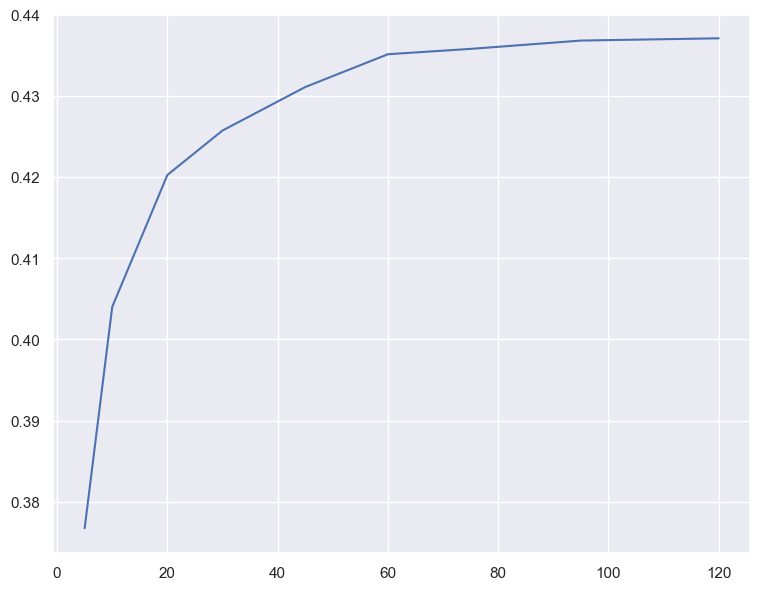

In [ ]:
results_knn_t = pd.DataFrame(knn_gscv_space.cv_results_)
plt.plot(results_knn_t["param_n_neighbors"], results_knn_t["mean_test_score"])

In [ ]:
knn_space_best = KNeighborsClassifier(n_neighbors=120)  
knn_space_best.fit(X_train, y_train)
y_pred = knn_space_best.predict(X_test)

# Evaluate the model
accuracy = accuracy_score(y_test, y_pred)
precision = precision_score(y_test, y_pred, average=None)
recall = recall_score(y_test, y_pred, average=None)

print(f'Accuracy: {accuracy}')
print(f'Precision: {precision}')
print(f'Recall: {recall}')

Accuracy: 0.4380497250087544
Precision: [0.         0.         0.         0.46107673 0.27042916 0.23052464
 0.        ]
Recall: [0.         0.         0.         0.91351226 0.11704835 0.01643991
 0.        ]


c:\Users\noord\Python\Lib\site-packages\sklearn\metrics\_classification.py:1471: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
# Evaluate the model
accuracy = accuracy_score(y_test, y_pred)
precision = precision_score(y_test, y_pred, average=None)
recall = recall_score(y_test, y_pred, average=None)

print(f'Accuracy: {accuracy}')
print(f'Precision: {precision}')
print(f'Recall: {recall}')

Accuracy: 0.39805065012672836
Precision: [0.         0.09338339 0.16754681 0.49322954 0.28676785 0.23048669
 0.06896552]
Recall: [0.         0.06494778 0.12755848 0.69336521 0.22764297 0.11496622
 0.0043573 ]


c:\Users\noord\Python\Lib\site-packages\sklearn\metrics\_classification.py:1471: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [64]:
# Split data into train and test sets
X_train, X_test, y_train, y_test = train_test_split(crime.loc[:, ~crime.columns.isin(["Case Number", "IUCR", "Description","Location","Date", "Primary Type", "Class", "Updated On", "Weekday", "FBI Code"])], crime["Class"], test_size=0.2, random_state=42, stratify = crime["Class"])
X_train[["Block",  "Location Description", "Beat"]] = X_train[["Block",  "Location Description", "Beat"]].astype("category")
X_test[["Block",  "Location Description", "Beat"]] = X_test[["Block",  "Location Description", "Beat"]].astype("category")

In [119]:
#  define the xgb model
xgb_space = XGBClassifier(enable_categorical=True)

# define grid
param_grid = {
    'max_depth': [3, 5],
    'learning_rate': [0.1, 0.01],
    'subsample': [0.5, 0.7],
    'colsample_bytree': [0.6, 0.8]
}

# evaluate the model
start = time.time()
gs_xgb_space = GridSearchCV(xgb_space, param_grid, cv=5, scoring='accuracy', verbose = 3)

gs_xgb_space.fit(X_train, y_train)
end = time.time()
print(f"Finished hyperparameter optimization in {round((end-start)/60, 2)} minutes")

# report performance
print("Best set of hyperparameters: ", gs_xgb_space.best_params_)
print("Best score: ", gs_xgb_space.best_score_)

Fitting 5 folds for each of 16 candidates, totalling 80 fits


c:\Users\noord\Python\Lib\site-packages\sklearn\model_selection\_split.py:737: UserWarning: The least populated class in y has only 3 members, which is less than n_splits=5.
  warnings.warn(


[CV 1/5] END colsample_bytree=0.6, learning_rate=0.1, max_depth=3, subsample=0.5;, score=0.578 total time=  34.3s
[CV 2/5] END colsample_bytree=0.6, learning_rate=0.1, max_depth=3, subsample=0.5;, score=0.583 total time=  33.1s
[CV 3/5] END colsample_bytree=0.6, learning_rate=0.1, max_depth=3, subsample=0.5;, score=0.582 total time=  33.0s
[CV 4/5] END colsample_bytree=0.6, learning_rate=0.1, max_depth=3, subsample=0.5;, score=0.576 total time=  32.9s


In [67]:
xgb_space_best = XGBClassifier(colsample_bytree= 0.6, learning_rate= 0.1, max_depth= 3, subsample= 0.5, enable_categorical=True)
xgb_space_best.fit(X_train, y_train)

y_pred = xgb_space_best.predict(X_test)

# Evaluate the model
accuracy = accuracy_score(y_test, y_pred)
precision = precision_score(y_test, y_pred, average=None)
recall = recall_score(y_test, y_pred, average=None)

print(f'Accuracy: {accuracy}')
print(f'Precision: {precision}')
print(f'Recall: {recall}')

Accuracy: 0.5114425196201619
Precision: [0.19736842 0.55429072 0.52958178 0.28881078 0.47610729 0.66      ]
Recall: [0.00484496 0.45670996 0.8493881  0.04155078 0.52671669 0.22197309]


In [118]:
# Extract Hour and Minute from the date column
crime_beat['Hour_minute'] = crime_beat["Date"].dt.time
crime_beat['Hour_minute']

# calculate sum of crime class per half hour per beat
half_hour_pattern = crime_beat.groupby(['Beat', 'Hour_minute', 'Class']).size().reset_index(name='halfhour_crime_count')
half_hour_pattern.sort_values(by=['Beat','Hour_minute']).head(20)

# # calculate sum of crime class per weekday per beat
weekly_pattern = crime_beat.groupby(['Beat', 'Weekday', 'Class']).size().reset_index(name='Daily_crime_count')
weekly_pattern


,Beat,Weekday,Class,Daily_crime_count
0,0111,0.0,1.0,6
1,0111,0.0,2.0,4
2,0111,0.0,3.0,157
3,0111,0.0,4.0,15
4,0111,0.0,5.0,24
...,...,...,...,...
10559,2535,6.0,2.0,6
10560,2535,6.0,3.0,34
10561,2535,6.0,4.0,47
10562,2535,6.0,5.0,21
